In [1]:
import warnings
warnings.filterwarnings("ignore")

import tensorflow as tf
import numpy as np
import pandas as pd

In [2]:
import tensorflow.compat.v1 as tfv

In [3]:
import matplotlib
import matplotlib.pyplot as plt

In [4]:
tf.compat.v1.disable_eager_execution()

## Build Layer

In [5]:
class TrainLayer(object):
    def __init__(self, input_dims, output_dims, n_clusters, name, kernel_size=(5, 5)):
        self.name = name
        self.kernel_size = kernel_size
        
        if "conv" in self.name:
            self.w = tf.Variable(initial_value=tf.random.normal((*kernel_size, input_dims, output_dims), 
                                                                stddev=0.1))
        elif "fc" in self.name:
            self.w = tf.Variable(initial_value=tf.random.normal([input_dims, output_dims], 
                                                                stddev=0.1))
        
        self.w_PH = tfv.placeholder(tf.float32, shape=self.w.shape)
        self.assign_w = tfv.assign(self.w, self.w_PH)
        self.num_total_weights = np.prod(self.w.shape)
        
        ### Create mask for pruning weight 
        self.pruning_mask_data = np.ones_like(self.w.shape, dtype=np.float32)
        
        ### Number of cluster for quantization
        self.n_clusters = n_clusters
    
    def forward(self, x):
        if "conv" in self.name:
            return tf.nn.conv2d(x, self.w, strides=[1, 1, 1, 1], padding="SAME")
        elif "fc" in self.name:
            return tf.matmul(x, self.w)
        
    def prune_weights(self, sess, threshold):
        w_data = sess.run(self.w)        
        self.pruning_mask_data = (w_data >= threshold).astype(np.float32)
        
        sess.run(self.assign_w, feed_dict={self.w_PH: self.pruning_mask_data*w_data})
        
    def prune_weights_gradient(self, grad):
        return grad * self.pruning_mask_data
    
    def prune_weights_update(self, sess):
        w_data = sess.run(self.w)
        
        sess.run(self.assign_w, feed_dict={self.w_PH: self.pruning_mask_data*w_data})    
        
    def save_weights_histogram(self, sess, directory, interaction):
        w_data = sess.run(self.w).reshape(-1)
        
        valid_w_data = [x for x in w_data if x!=0.0]
        
        plt.grid(True)
        plt.hist(valid_w_data, 100, color="0.4")
        plt.gca().set_xlim([-0.4, 0.4])
        plt.savefig(directory + '/' + self.name + '-' + str(interaction), dpi=100)
        plt.gcf().clear()
        
    def save_weights(self, sess, directory):
        w_data = sess.run(self.w)
        np.save(directory + '/' + self.name + '-weights', w_data)
        np.save(directory + '/' + self.name + '-prune-mask', self.pruning_mask_data)
        
    # ----quantization----
    def quantize_weights(self, sess):
        w_data = sess.run(self.w)
        max_val = np.max(w_data)
        min_val = np.min(w_data)
        
        self.centroids = np.linspace(min_val, max_val, self.n_clusters)
        w_data = np.expand_dims(w_data, 0)
        
        centroids_prev = np.copy(self.centroids)
        
        for i in range(30):
            if 'conv' in self.name:
                distances = np.abs(w_data - np.reshape(self.centroids, (-1, 1, 1, 1, 1)))
                distances = np.transpose(distances, (1, 2, 3, 4, 0))
            elif 'fc' in self.name:
                distances = np.abs(w_data - np.reshape(self.centroids, (-1, 1, 1)))
                distances = np.transpose(distances, (1, 2, 0))
            
            classes = np.argmin(distances, axis=-1)            
            self.cluster_masks = []
            
            for i in range(self.n_clusters):
                cluster_mask = (classes == i).astype(np.float32) * self.pruning_mask_data
                self.cluster_masks.append(cluster_mask)
                num_weights_assigned = np.sum(cluster_mask)
                
                if num_weights_assigned != 0:
                    self.centroids[i] = np.sum(cluster_mask * w_data) / num_weights_assigned
                else:
                    pass
            
            if np.array_equal(centroids_prev, self.centroids):
                break
                
            centroids_prev = np.copy(self.centroids)
        
        self.quantize_weights_update(sess)
        
    def quantize_weights_update(self, sess):
        w_data_updated = np.zeros(self.w.shape, dtype=np.float32)
        
        for i in range(self.n_clusters):
            cluster_mask = self.cluster_masks[i]
            centroid = self.centroids[i]
            
            w_data_updated = w_data_updated + cluster_mask * centroid
            
        sess.run(self.assign_w, feed_dict={self.w_PH: self.pruning_mask_data * w_data_updated})
    
    def quantize_centroids_update(self, sess):
        w_data = sess.run(self.w)
        
        for i in range(self.n_clusters):
            cluster_mask = self.cluster_masks[i]
            cluster_count = np.sum(cluster_mask)
        
            if cluster_count != 0:
                self.centroids[i] = np.sum(cluster_mask * w_data) / cluster_count
            else:
                pass
            
    def group_and_reduce_gradient(self, grad):
        grad_out = np.zeros(self.w.shape, dtype=np.float32)
        
        for i in range(self.n_clusters):
            cluster_mask = self.cluster_masks[i]
            centroid_grad = np.sum(grad * cluster_mask)
            
            grad_out = grad_out + cluster_mask * centroid_grad
        
        return grad_out

## Training

In [6]:
import os

In [7]:
histograms_dir = 'histograms'
weights_dir = 'weights'

In [8]:
def make_dir(directory):
    if not os.path.exists(directory):
        os.mkdir(directory)

In [9]:
make_dir(histograms_dir)
make_dir(weights_dir)

In [10]:
L1 = TrainLayer(1, 32, 11, "conv_1", kernel_size=(3, 3))
L2 = TrainLayer(32, 64, 15, "conv_2", kernel_size=(3, 3))
L3 = TrainLayer(64, 128, 25, "conv_3", kernel_size=(3, 3))
L4 = TrainLayer(128, 256, 31, "conv_4", kernel_size=(3, 3))
L5 = TrainLayer(7*7*256, 1024, 51, "fc1")
L6 = TrainLayer(1024, 128, 25, "fc2")
L7 = TrainLayer(128, 10, 10, "fc3")

Instructions for updating:
If using Keras pass *_constraint arguments to layers.


In [11]:
LAYERS = [L1, L2, L3, L4, L5, L6, L7]
LAYER_WEIGHTS = [L1.w, L2.w, L3.w, L4.w, L5.w, L6.w, L7.w]

In [12]:
inputs = tfv.placeholder(tf.float32, [None, 28, 28, 1])

In [13]:
x = tf.nn.relu(L1.forward(inputs))

In [14]:
# x = tf.nn.batch_normalization(x)

In [15]:
x = tf.nn.relu(L2.forward(x))

In [16]:
x = tf.nn.max_pool2d(x, ksize=3, strides=2, padding="SAME")

In [17]:
x = tf.nn.relu(L3.forward(x))
x = tf.nn.relu(L4.forward(x))

In [18]:
x = tf.nn.max_pool2d(x, ksize=3, strides=2, padding="SAME")

In [19]:
x.shape

TensorShape([None, 7, 7, 256])

In [20]:
x = tf.reshape(x, (-1, np.product(x.shape[1:])))

In [21]:
x = tf.nn.relu(L5.forward(x))

In [22]:
x = tf.nn.relu(L6.forward(x))

In [23]:
x.shape

TensorShape([None, 128])

In [24]:
logits = L7.forward(x)

In [25]:
preds = tf.nn.softmax(x)

In [26]:
labels = tfv.placeholder(tf.float32, [None, 10])

In [27]:
loss = tf.reduce_mean(tf.nn.softmax_cross_entropy_with_logits(labels=labels, logits=logits))

In [28]:
optimizer = tf.compat.v1.train.AdamOptimizer(1e-4)

In [29]:
gradients_vars = optimizer.compute_gradients(loss, LAYER_WEIGHTS)

In [30]:
grads = [grad for grad, var in gradients_vars]

In [31]:
train_step = optimizer.apply_gradients(gradients_vars)

In [32]:
correct_prediction = tf.equal(tf.argmax(logits, -1), tf.argmax(labels, -1))

In [33]:
accuracy = tf.reduce_mean(tf.cast(correct_prediction, tf.float32))

In [34]:
sess = tfv.Session()

In [35]:
sess.run(tf.compat.v1.initialize_all_variables())

Instructions for updating:
Use `tf.global_variables_initializer` instead.


## Load data for training

In [36]:
import tensorflow_datasets as tfds

In [37]:
import input_data

In [38]:
# tfds.disable_progress_bar()

In [39]:
# tfv.enable_v2_behavior()

In [40]:
# (ds_train, ds_test), ds_info = tfds.load(
#     'mnist',
#     split=['train', 'test'],
#     shuffle_files=True,
#     as_supervised=True,
#     with_info=True,
# )

In [41]:
# def normalize_img(image, label):
#     return tf.cast(image, tf.float32)/255., label

In [42]:
# ds_train = ds_train.map(
#     normalize_img, num_parallel_calls=tf.data.experimental.AUTOTUNE)

In [43]:
# ds_train = ds_train.cache()

In [44]:
# ds_train = ds_train.shuffle(ds_info.splits['train'].num_examples)

In [45]:
# ds_train = ds_train.batch(50)

In [46]:
# ds_train = ds_train.prefetch(tf.data.experimental.AUTOTUNE)

In [47]:
mnist = input_data.read_data_sets("MNIST_data/", one_hot=True)

Instructions for updating:
Please use alternatives such as: tensorflow_datasets.load('mnist')
Instructions for updating:
Please write your own downloading logic.
Instructions for updating:
Please use tf.data to implement this functionality.
Extracting MNIST_data/train-images-idx3-ubyte.gz
Instructions for updating:
Please use tf.data to implement this functionality.
Extracting MNIST_data/train-labels-idx1-ubyte.gz
Instructions for updating:
Please use tf.one_hot on tensors.
Extracting MNIST_data/t10k-images-idx3-ubyte.gz
Extracting MNIST_data/t10k-labels-idx1-ubyte.gz
Instructions for updating:
Please use alternatives such as official/mnist/_DataSet.py from tensorflow/models.


In [48]:
iters = []
iters_acc = []

In [49]:
def plot_accuracy(i):
#     if i%10 == 0:
    batches_acc = []
    for j in range(5):
        batch_X, batch_y = mnist.test.next_batch(500)
        batch_X = np.reshape(batch_X,(-1, 28, 28,1))

        batch_acc = sess.run(accuracy,feed_dict={inputs: batch_X, labels: batch_y})
        batches_acc.append(batch_acc)

    acc = np.mean(batches_acc)
    print('iter:', i, 'test accuracy:', acc)
        
    return acc

iter: 0 test accuracy: 0.1204
iter: 20 test accuracy: 0.6996
iter: 40 test accuracy: 0.84720004
iter: 60 test accuracy: 0.8728
iter: 80 test accuracy: 0.89519995
iter: 100 test accuracy: 0.908
iter: 120 test accuracy: 0.92280006
iter: 140 test accuracy: 0.9328
iter: 160 test accuracy: 0.91639996
iter: 180 test accuracy: 0.912
iter: 200 test accuracy: 0.9139999
iter: 220 test accuracy: 0.93079996
iter: 240 test accuracy: 0.9068
iter: 260 test accuracy: 0.9396
iter: 280 test accuracy: 0.93880004
iter: 300 test accuracy: 0.9368
iter: 320 test accuracy: 0.9511999
iter: 340 test accuracy: 0.95439994
iter: 360 test accuracy: 0.93640006
iter: 380 test accuracy: 0.9252
iter: 400 test accuracy: 0.926
iter: 420 test accuracy: 0.94879997
iter: 440 test accuracy: 0.954
iter: 460 test accuracy: 0.9636
iter: 480 test accuracy: 0.9628
iter: 500 prune weights
iter: 500 test accuracy: 0.096
iter: 520 test accuracy: 0.10520001
iter: 540 test accuracy: 0.0924
iter: 560 test accuracy: 0.2148
iter: 580 tes

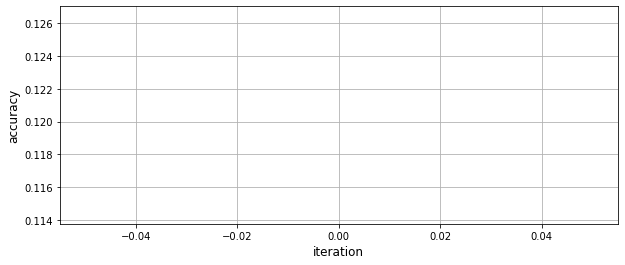

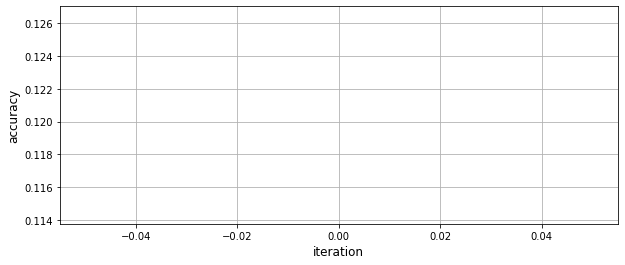

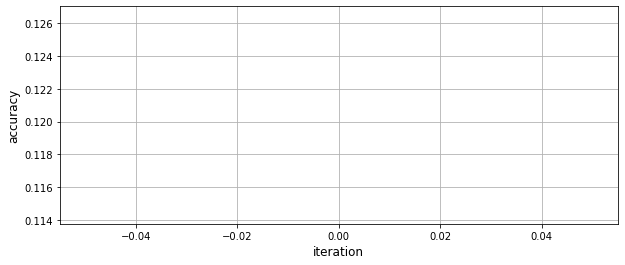

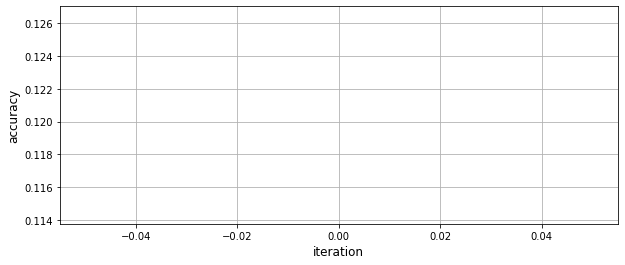

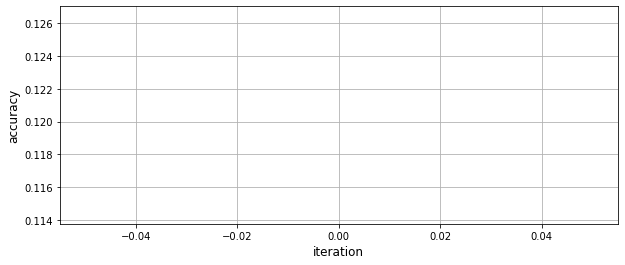

...

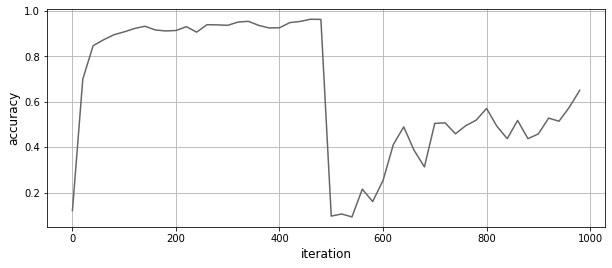

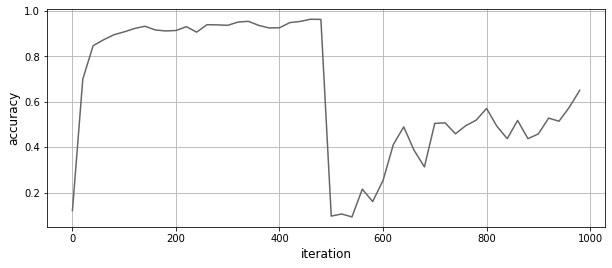

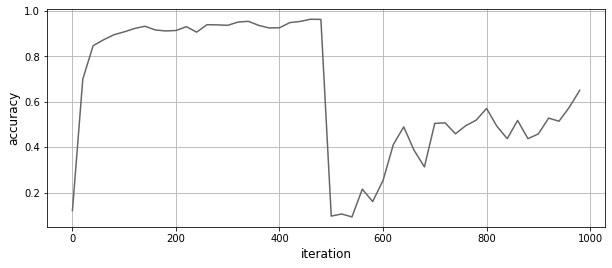

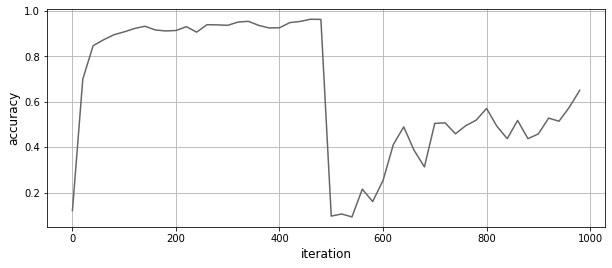

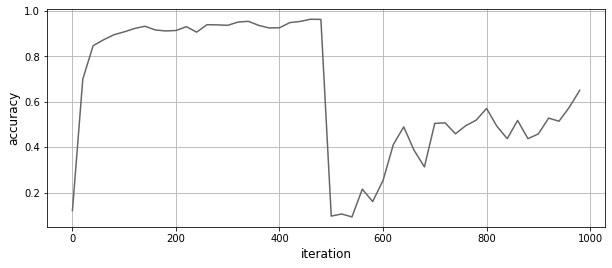

<Figure size 720x288 with 0 Axes>

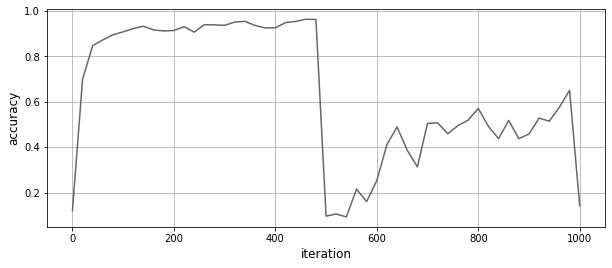

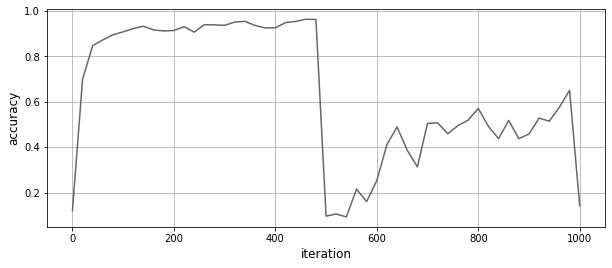

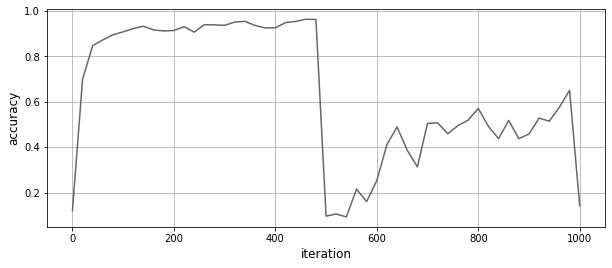

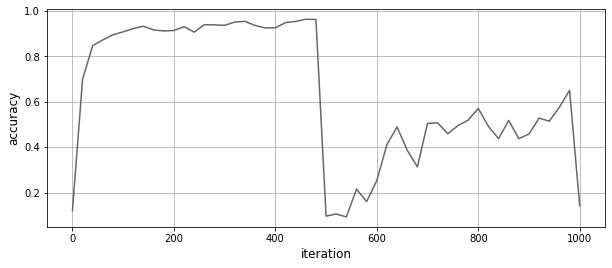

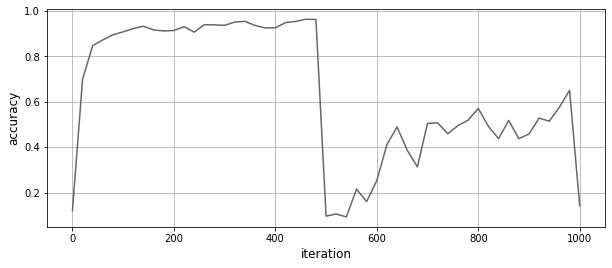

...

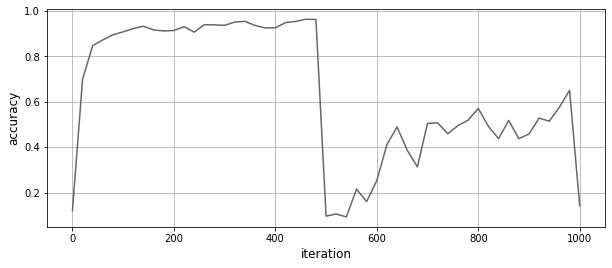

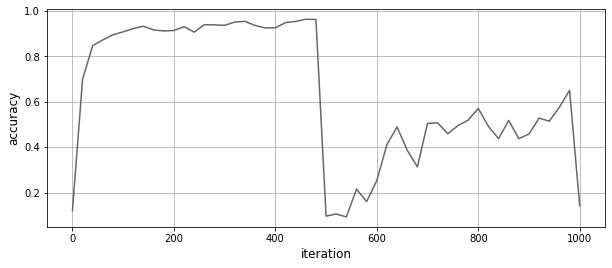

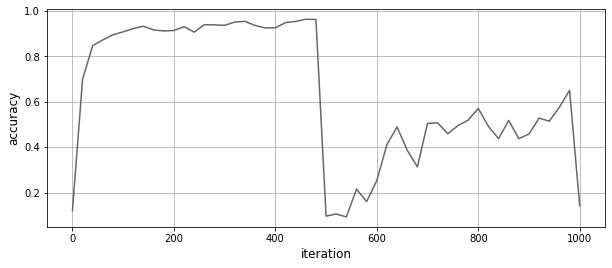

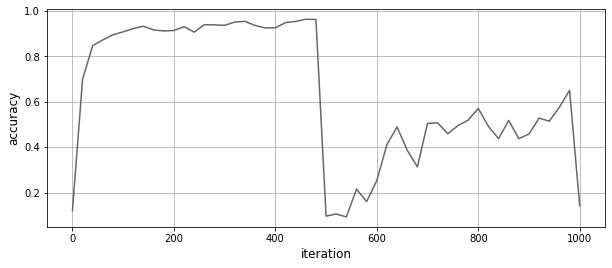

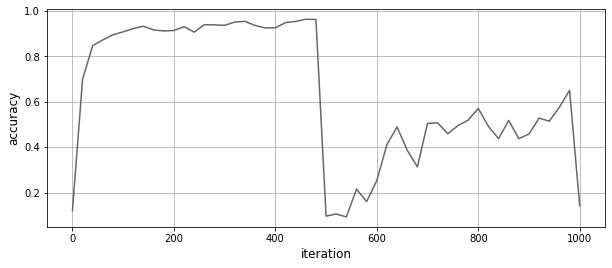

<Figure size 720x288 with 0 Axes>

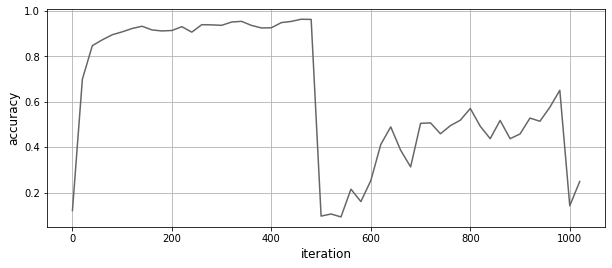

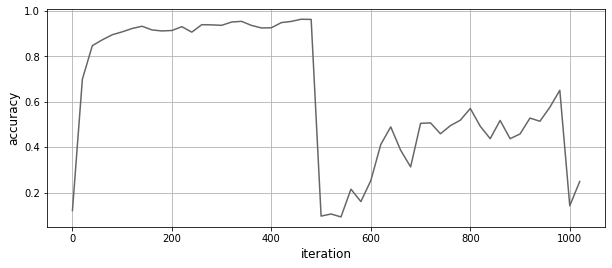

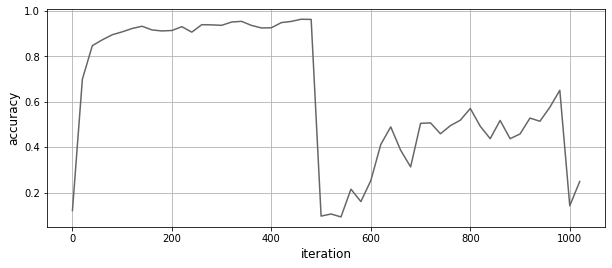

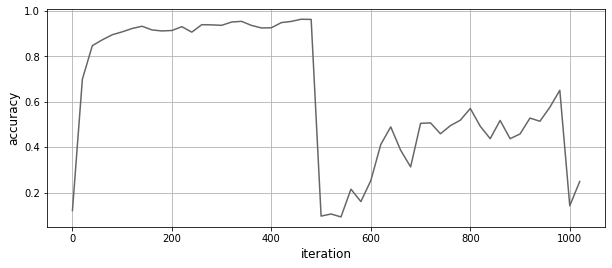

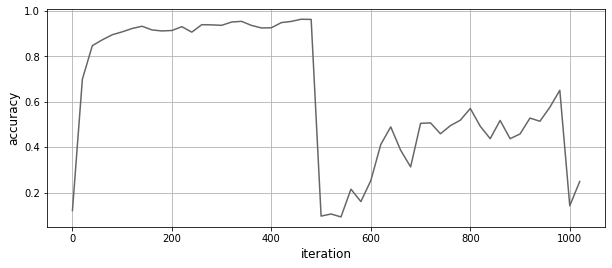

...

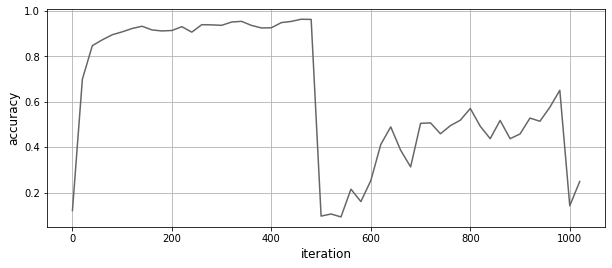

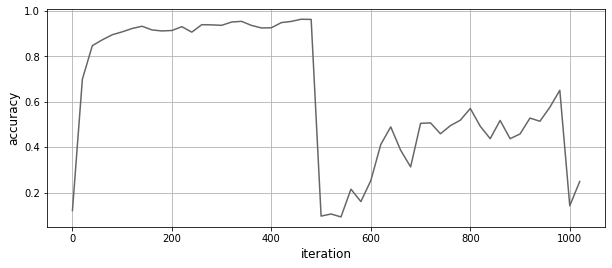

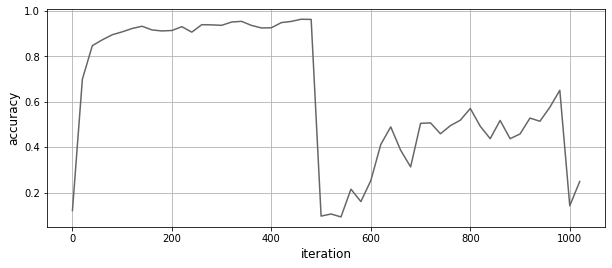

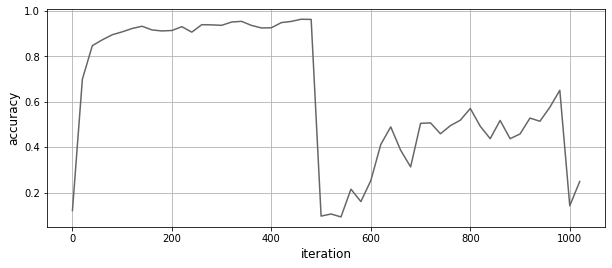

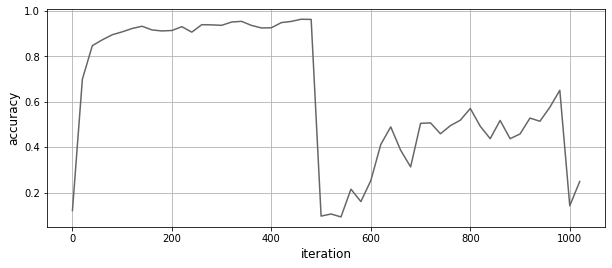

<Figure size 720x288 with 0 Axes>

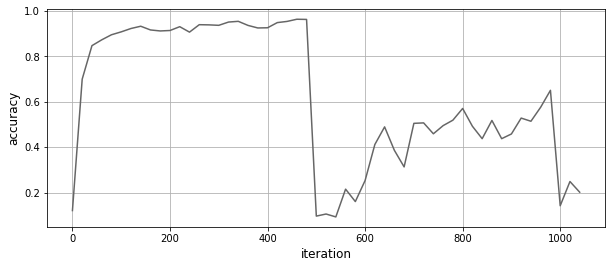

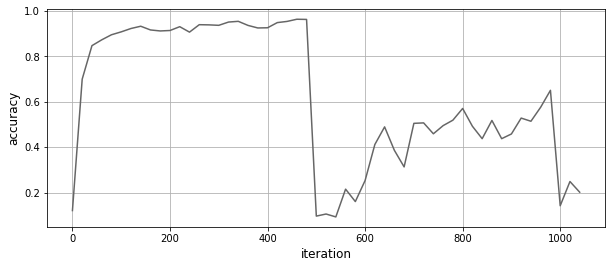

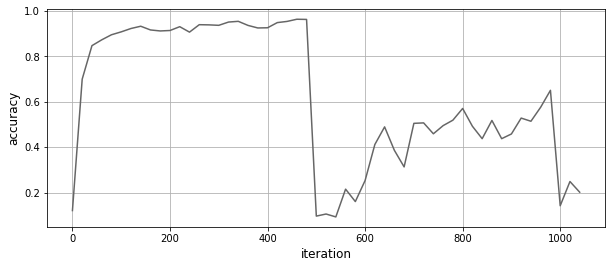

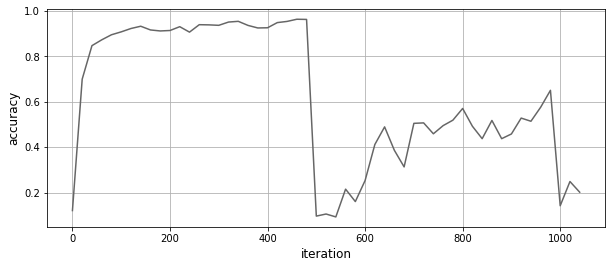

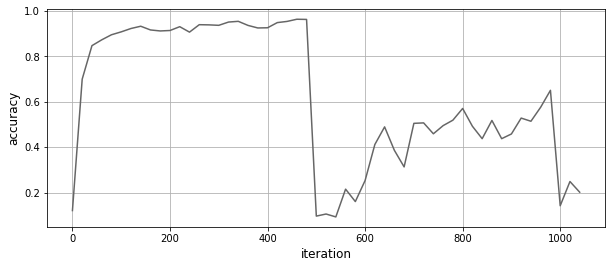

...

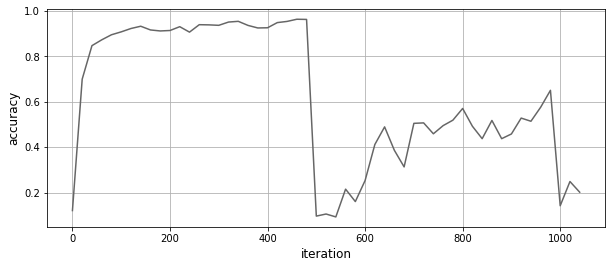

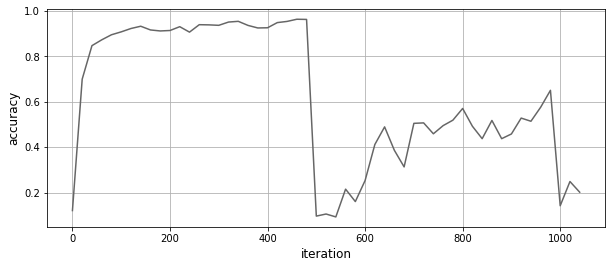

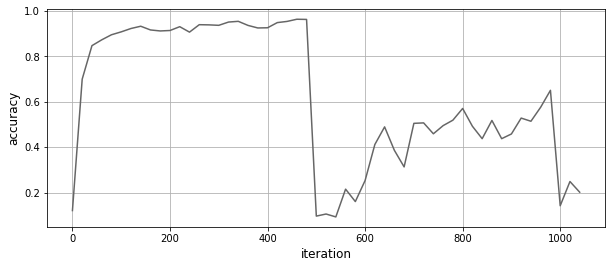

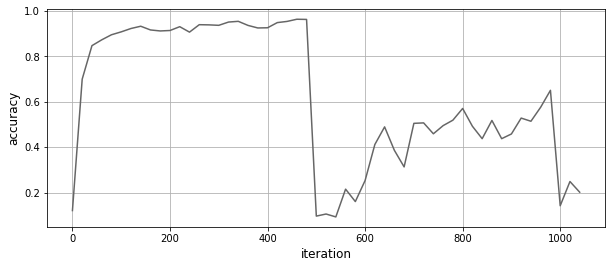

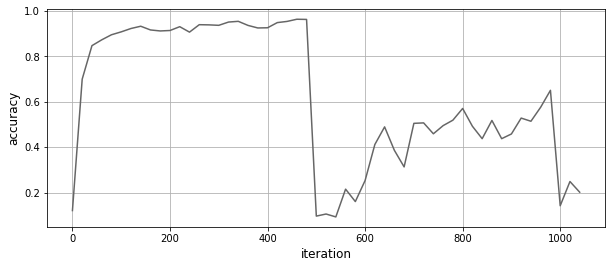

<Figure size 720x288 with 0 Axes>

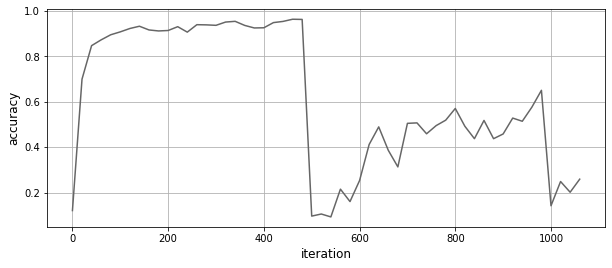

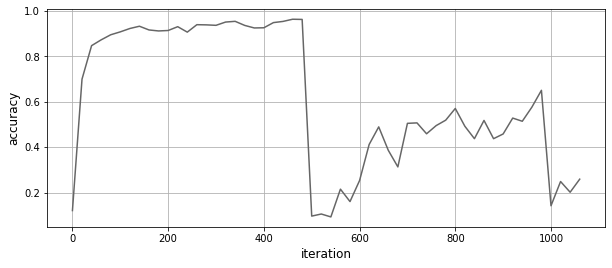

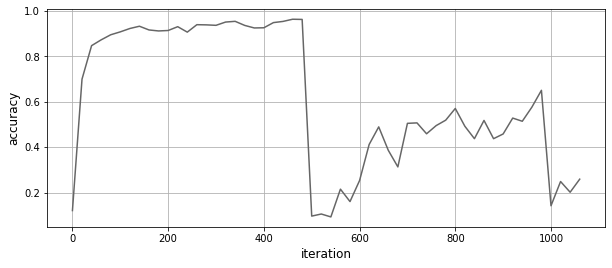

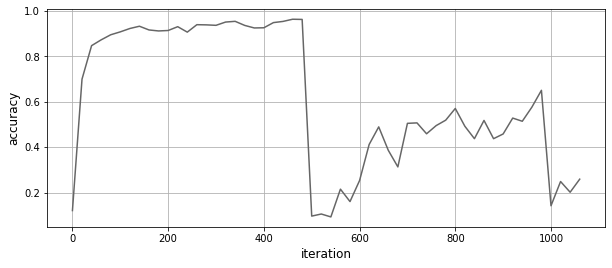

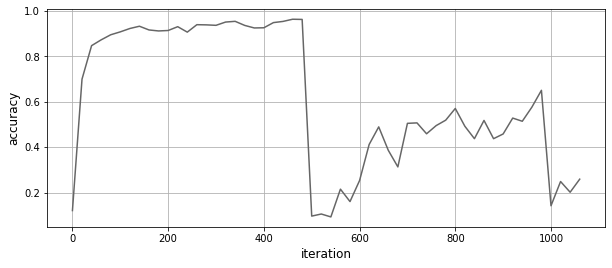

...

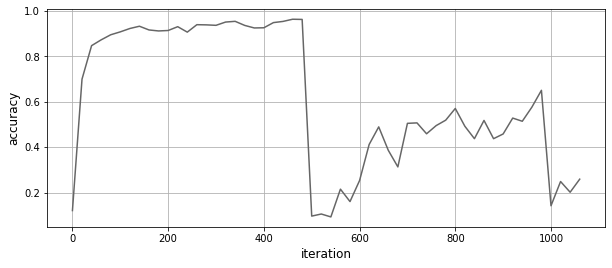

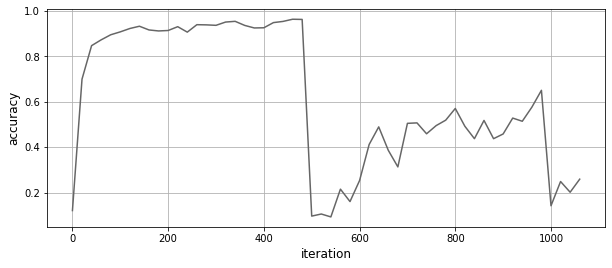

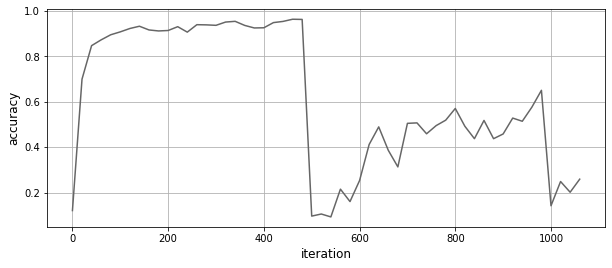

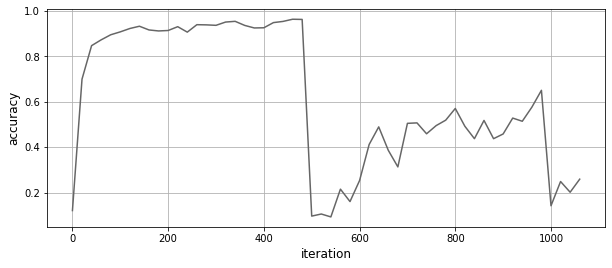

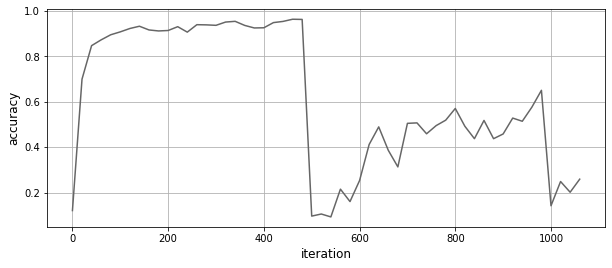

<Figure size 720x288 with 0 Axes>

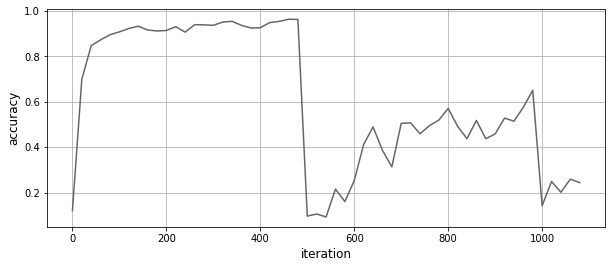

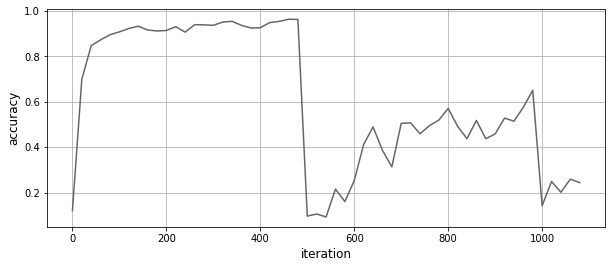

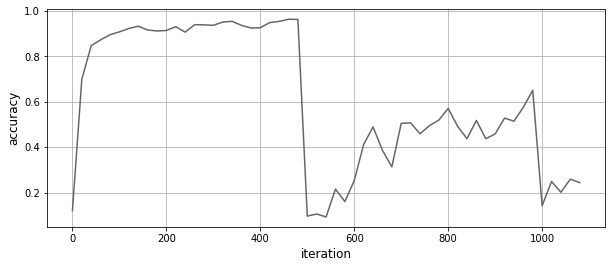

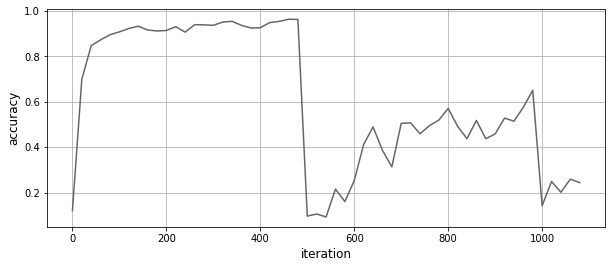

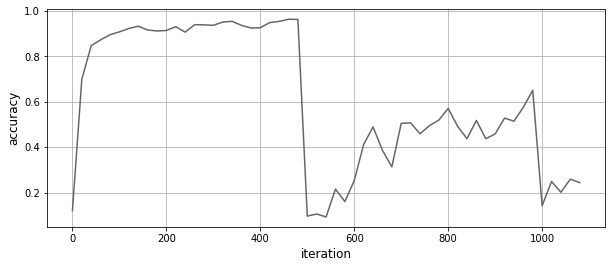

...

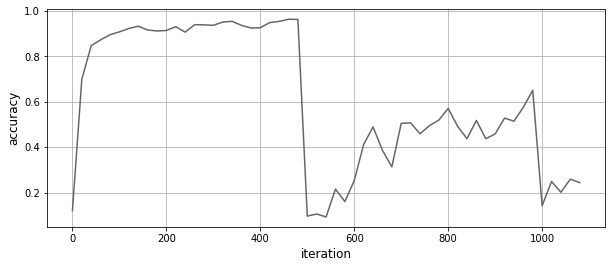

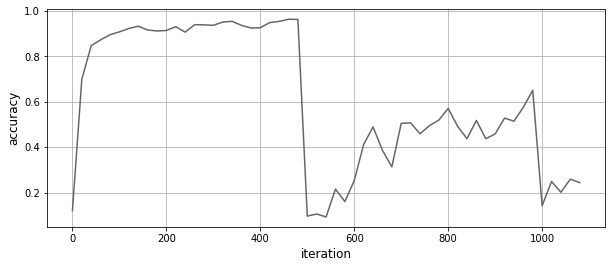

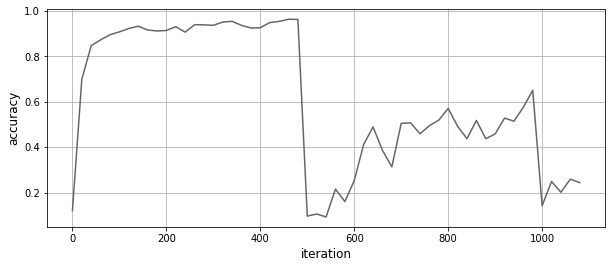

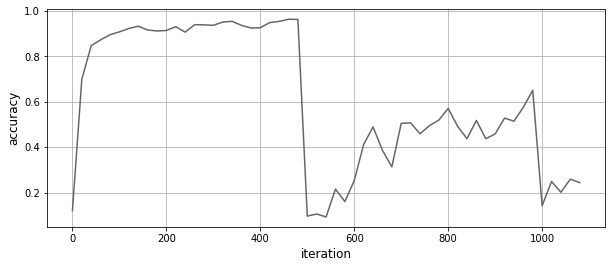

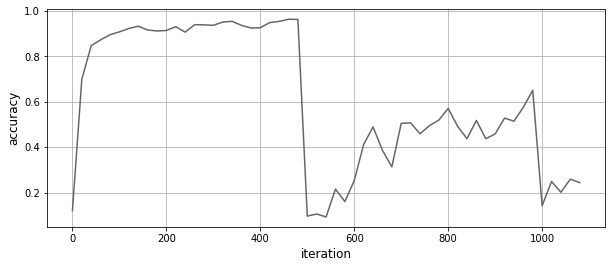

<Figure size 720x288 with 0 Axes>

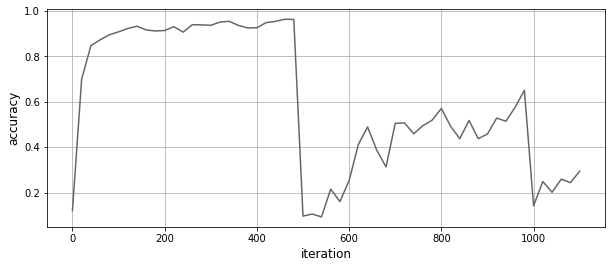

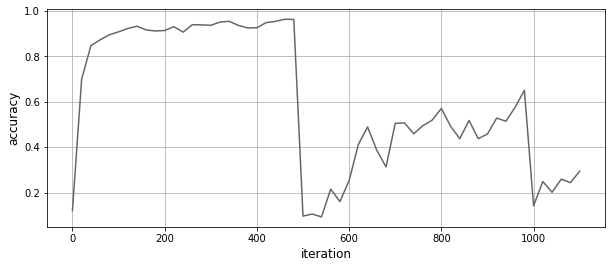

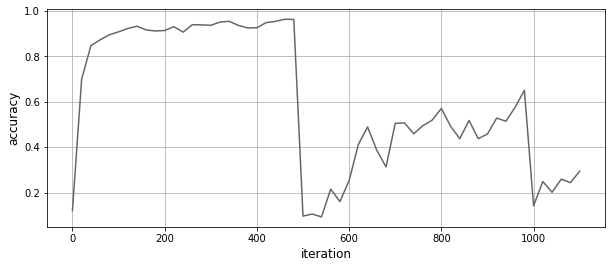

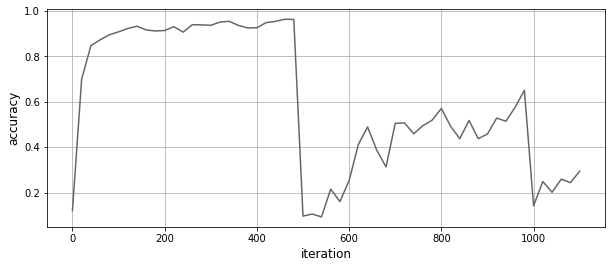

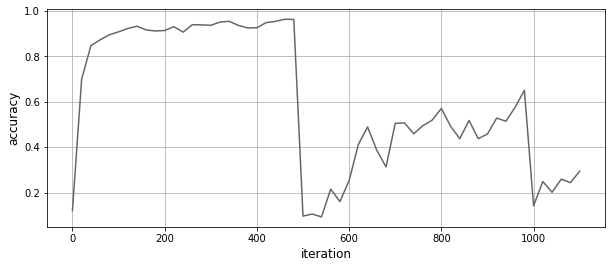

...

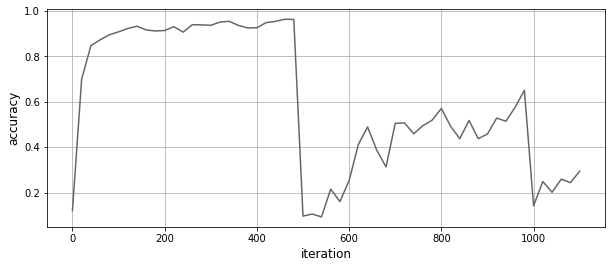

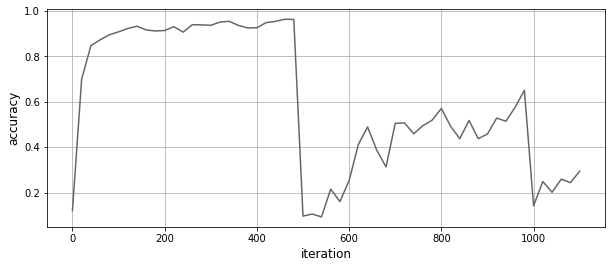

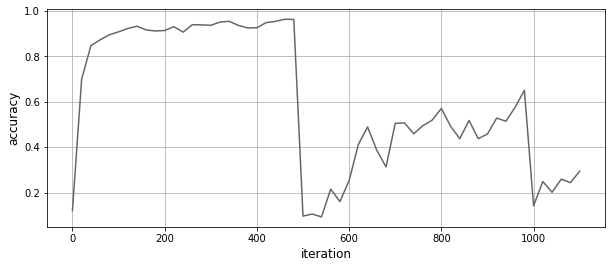

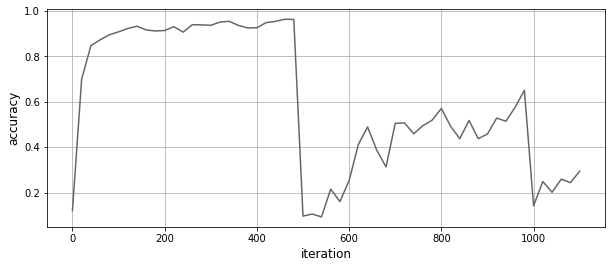

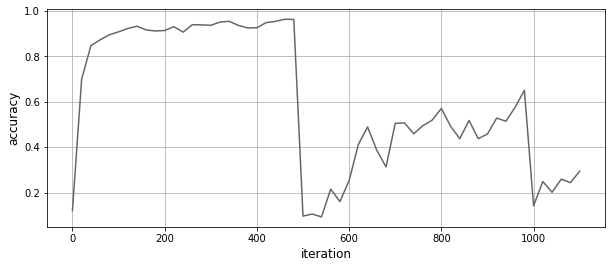

<Figure size 720x288 with 0 Axes>

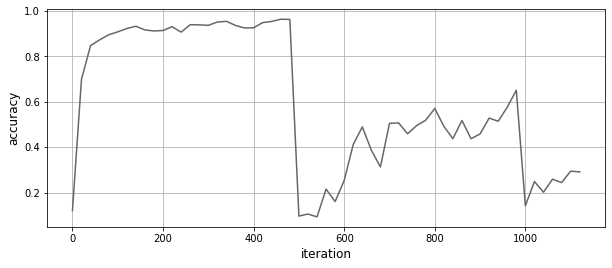

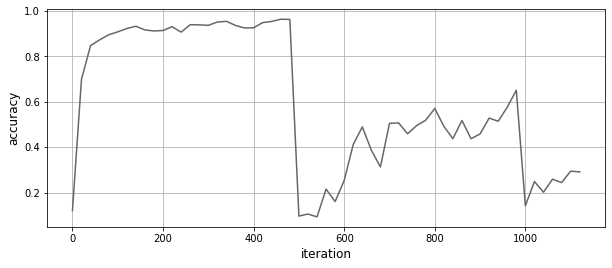

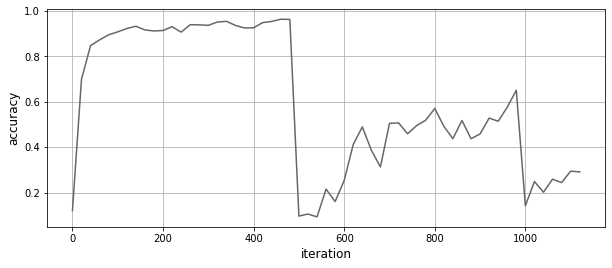

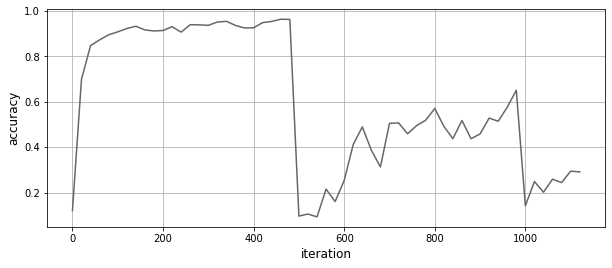

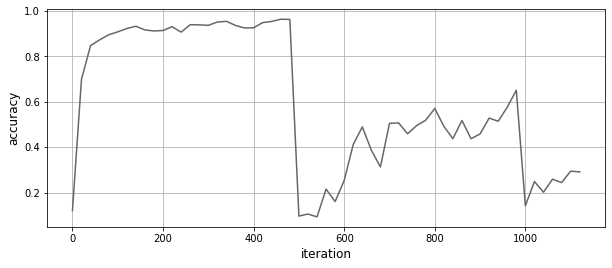

...

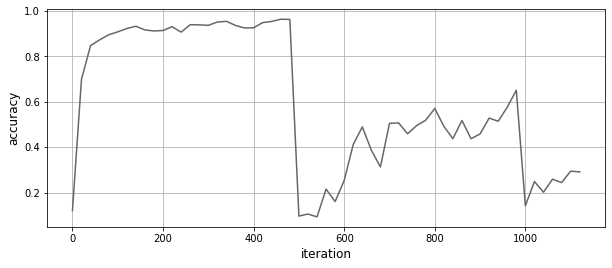

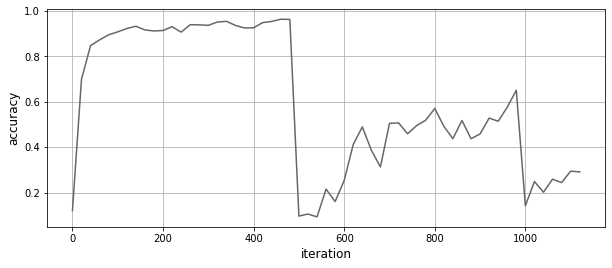

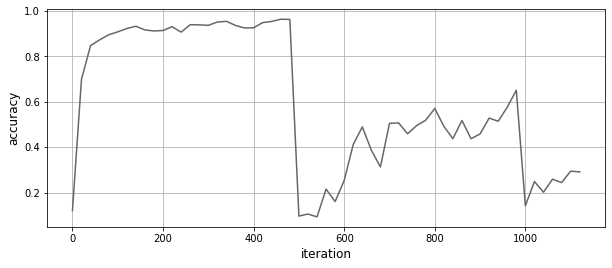

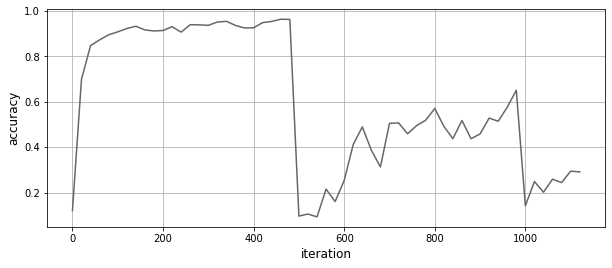

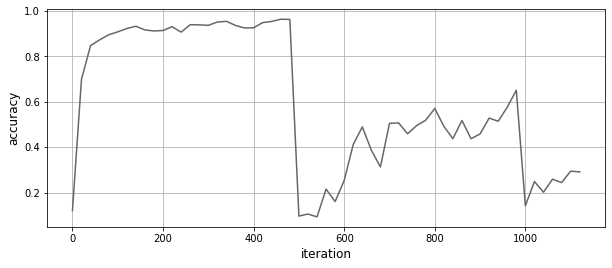

<Figure size 720x288 with 0 Axes>

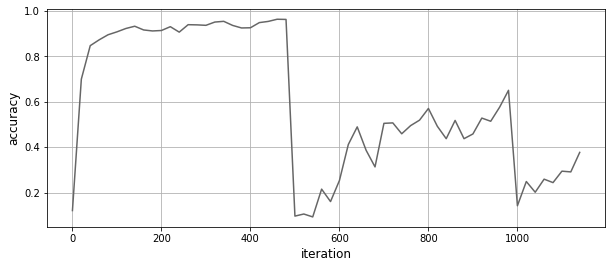

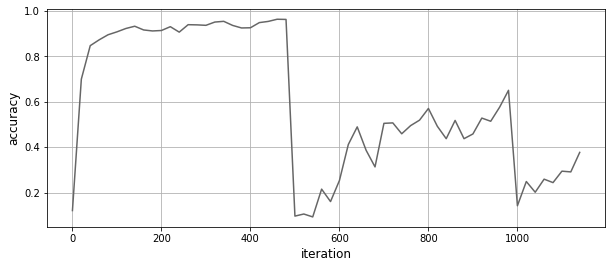

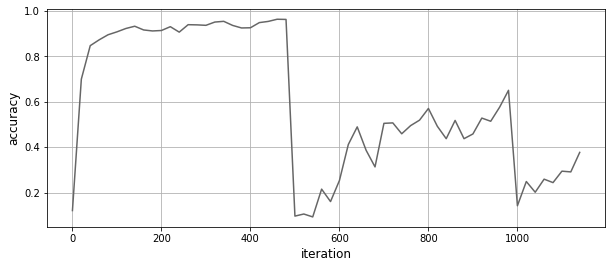

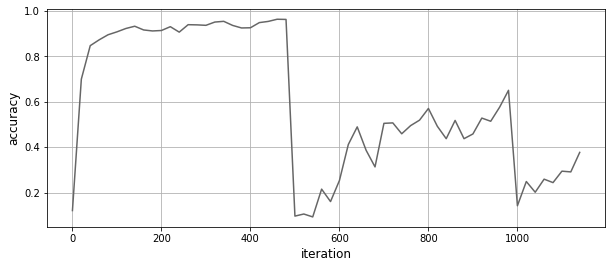

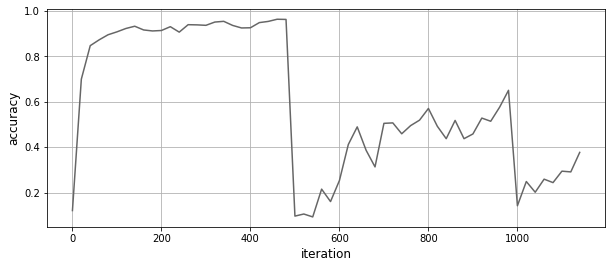

...

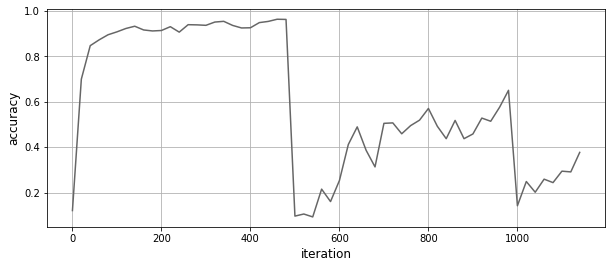

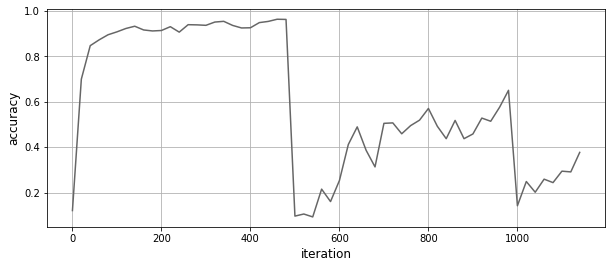

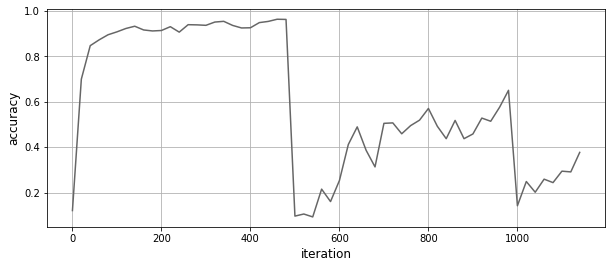

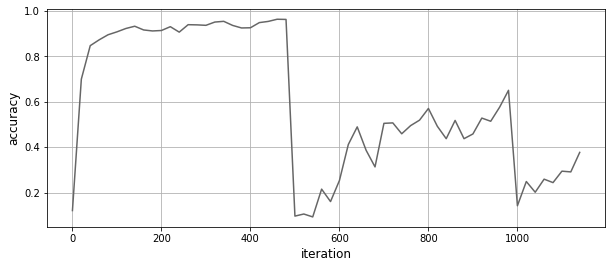

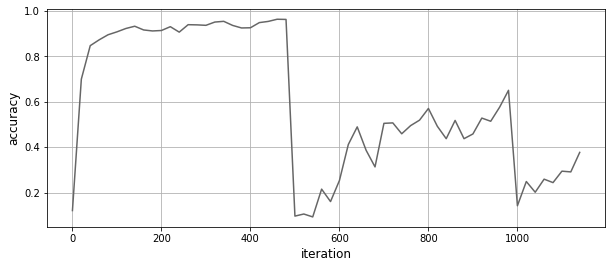

<Figure size 720x288 with 0 Axes>

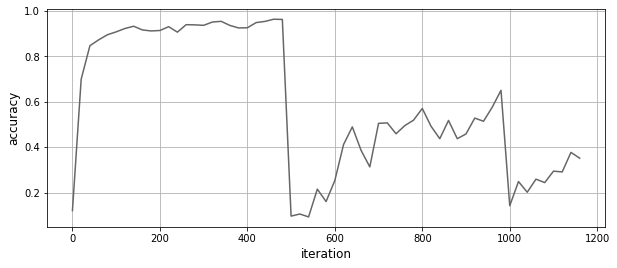

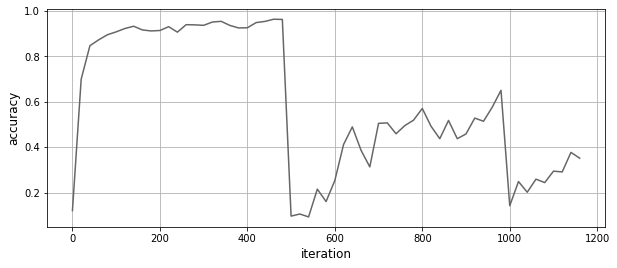

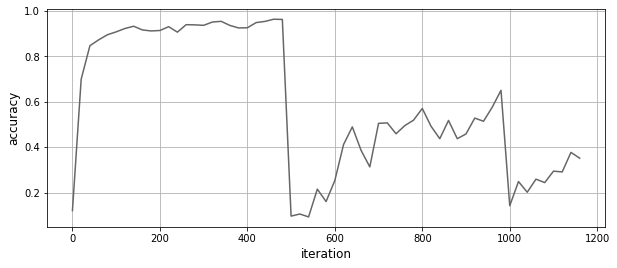

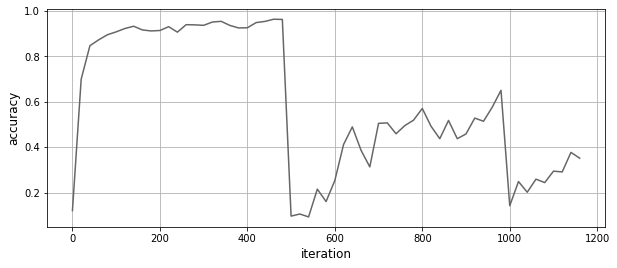

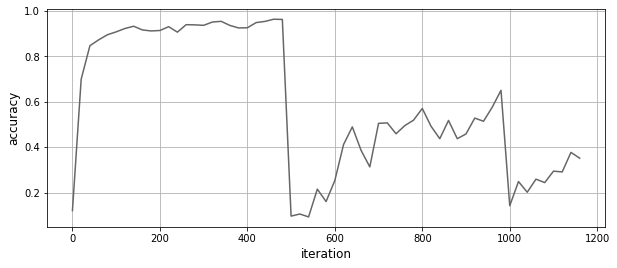

...

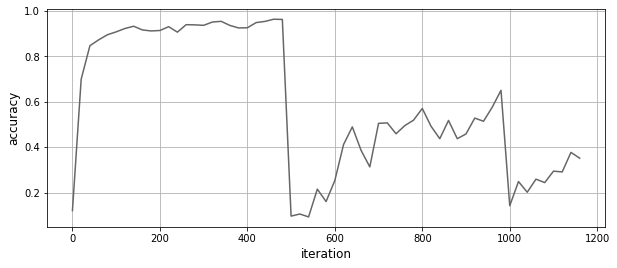

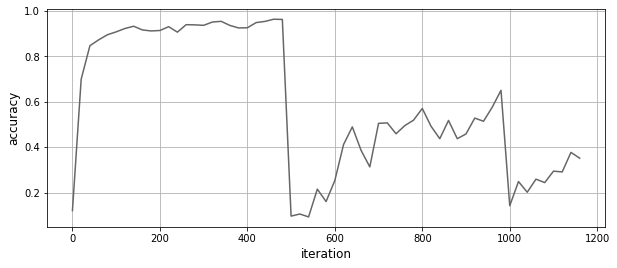

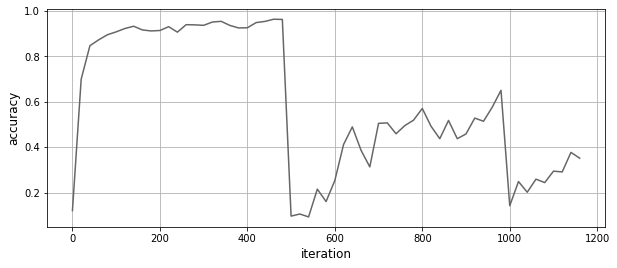

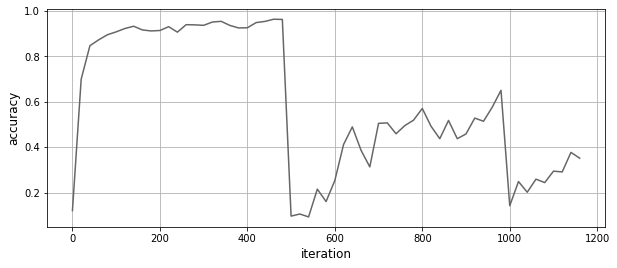

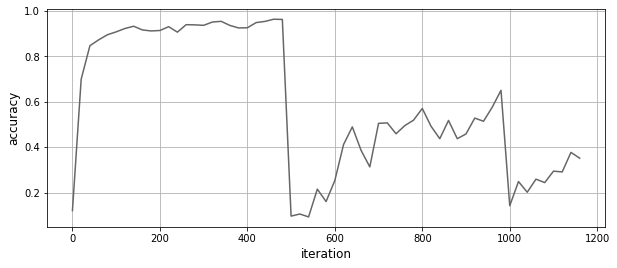

<Figure size 720x288 with 0 Axes>

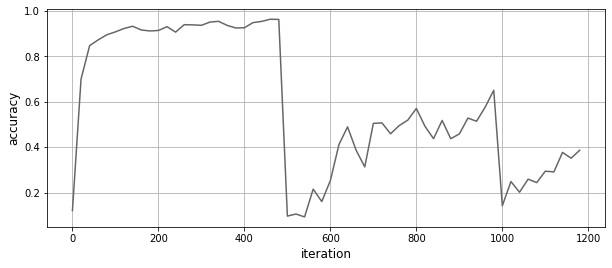

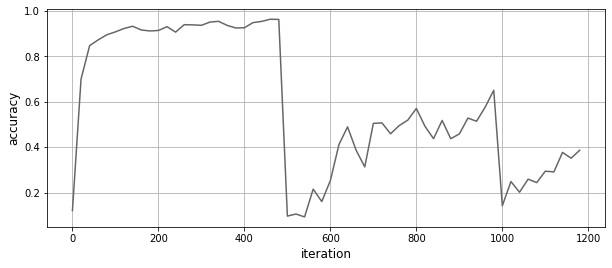

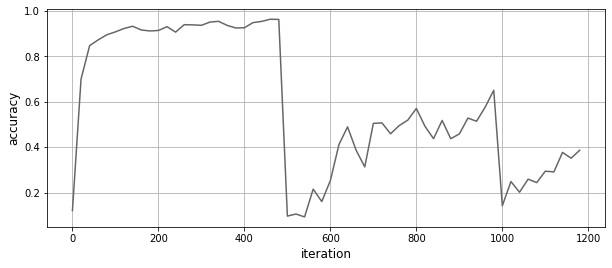

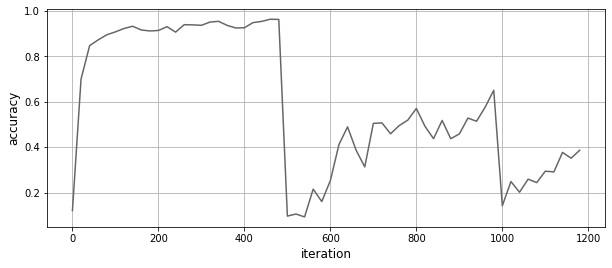

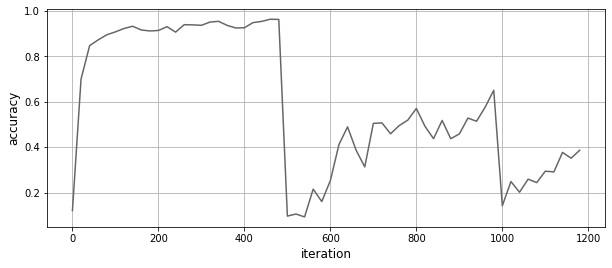

...

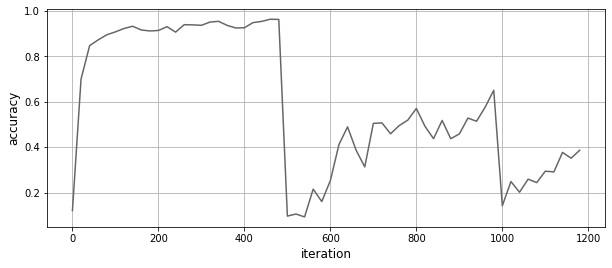

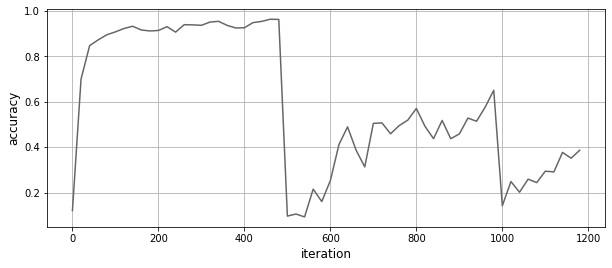

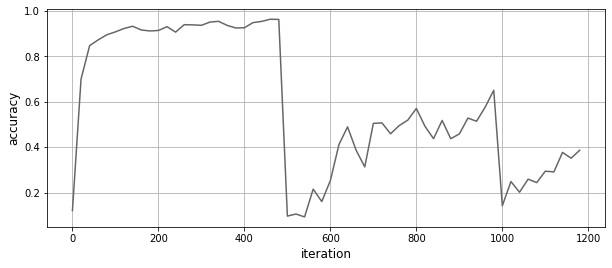

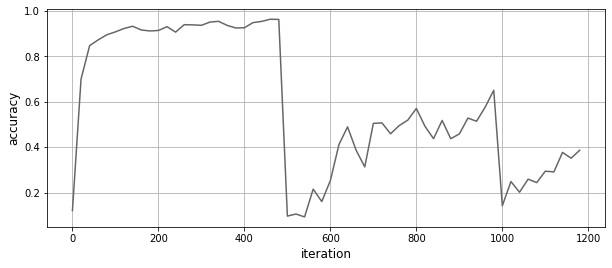

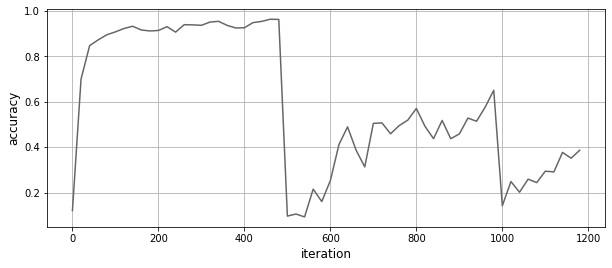

<Figure size 720x288 with 0 Axes>

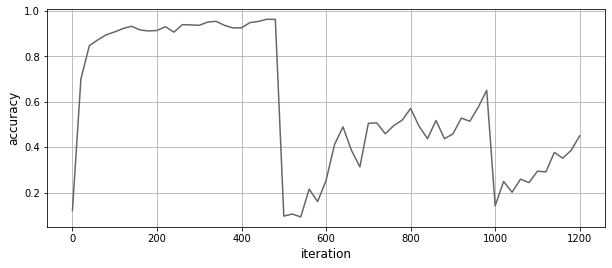

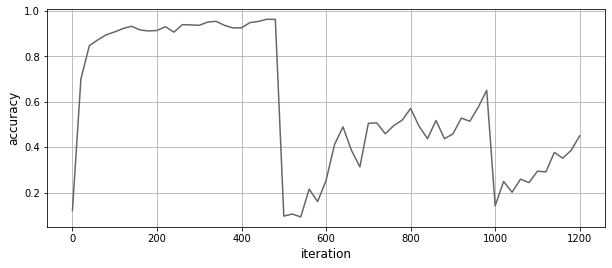

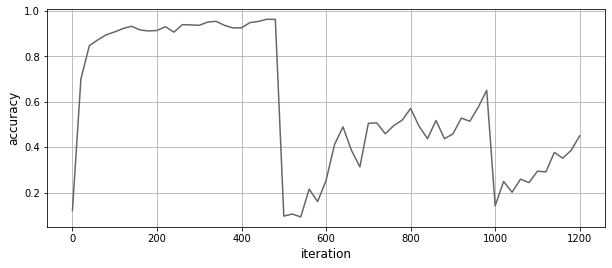

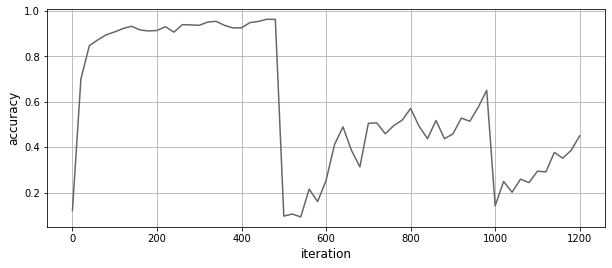

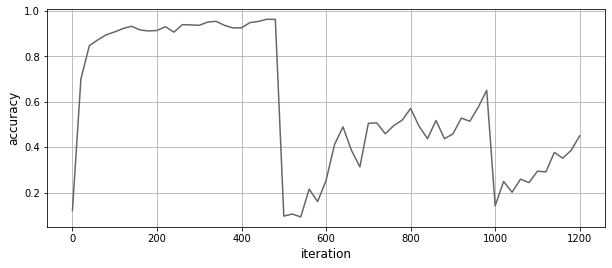

...

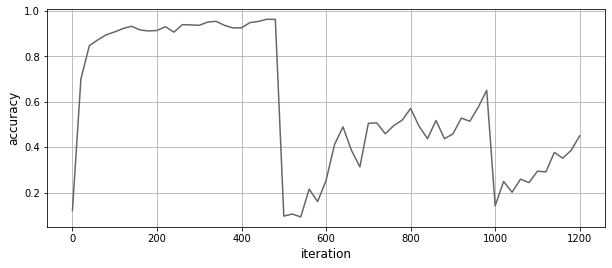

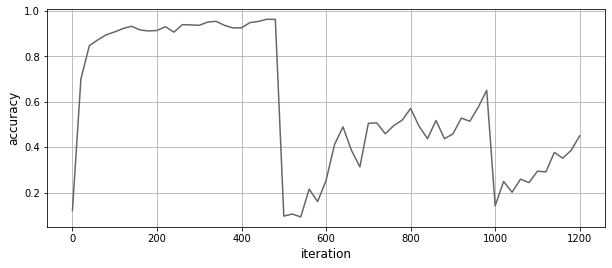

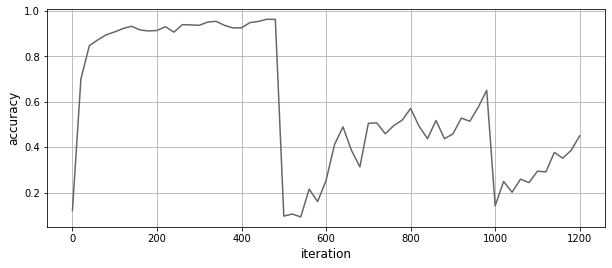

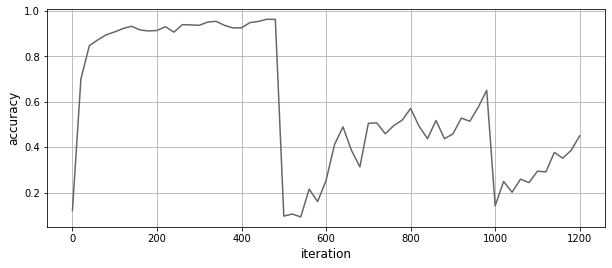

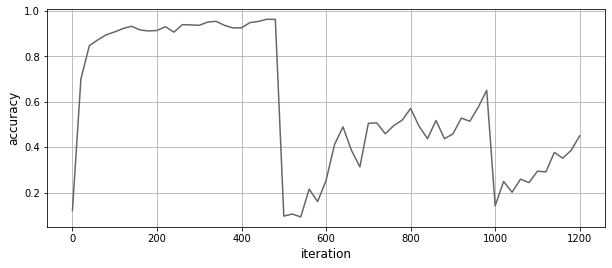

<Figure size 720x288 with 0 Axes>

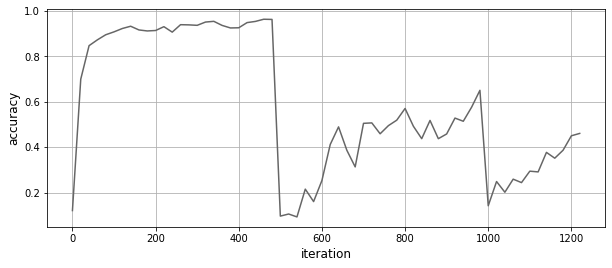

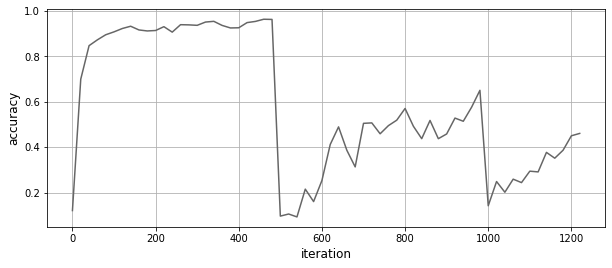

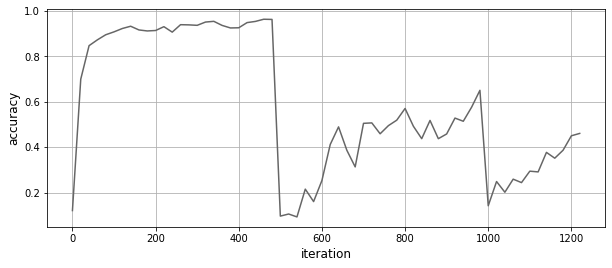

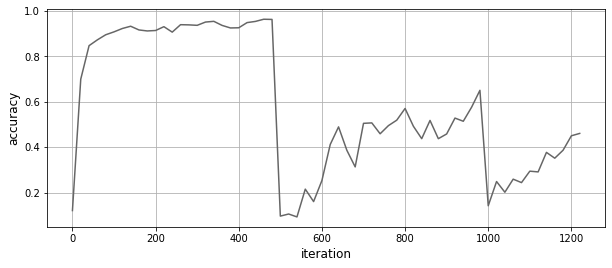

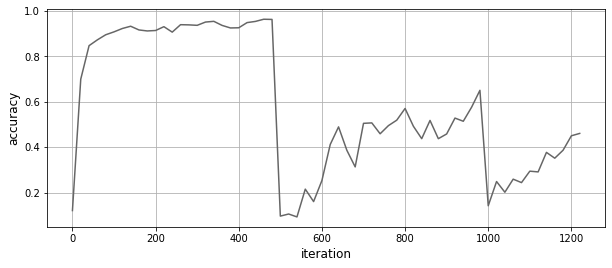

...

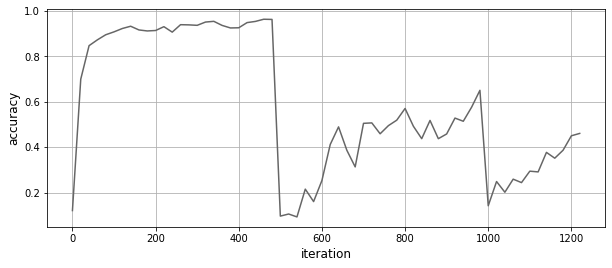

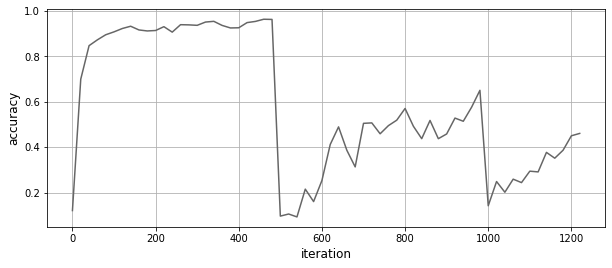

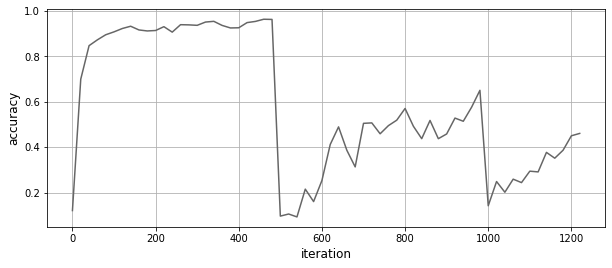

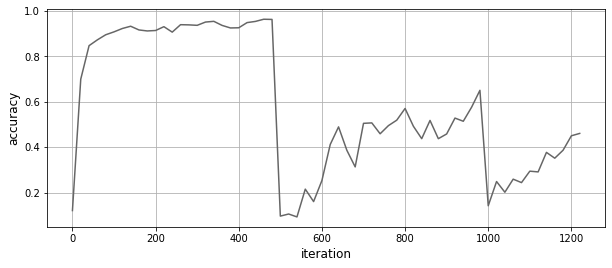

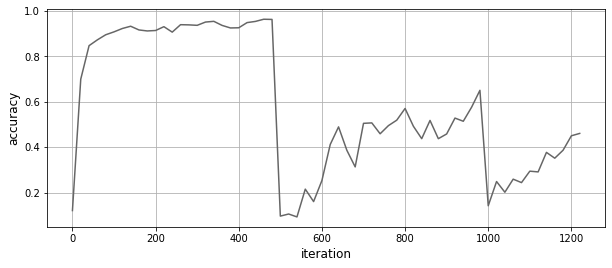

<Figure size 720x288 with 0 Axes>

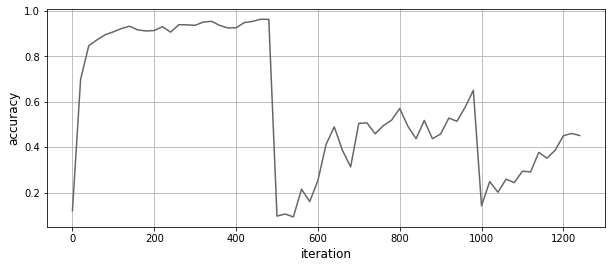

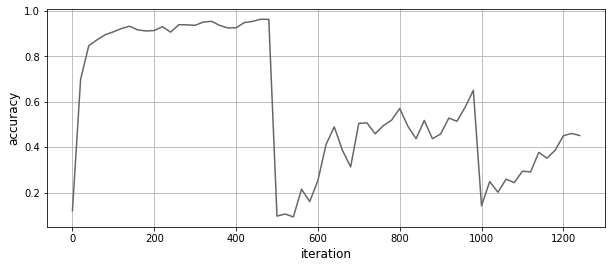

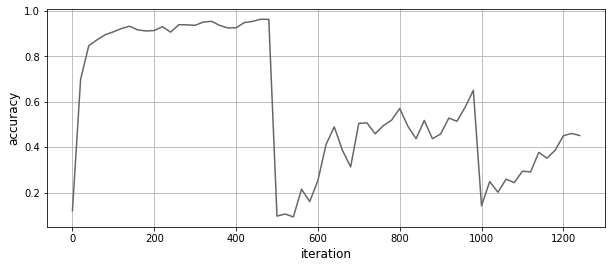

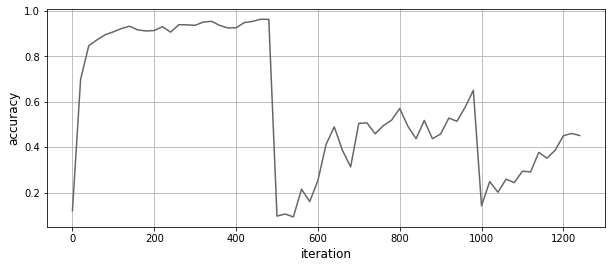

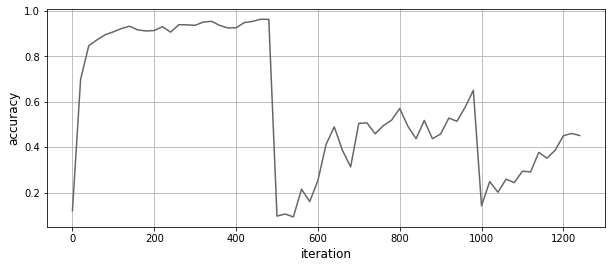

...

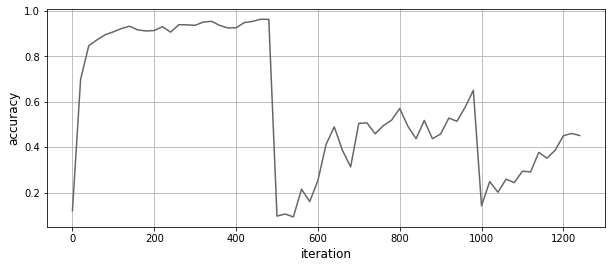

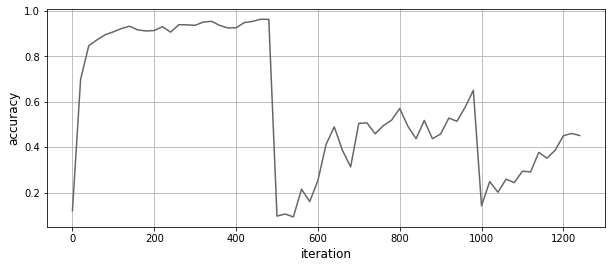

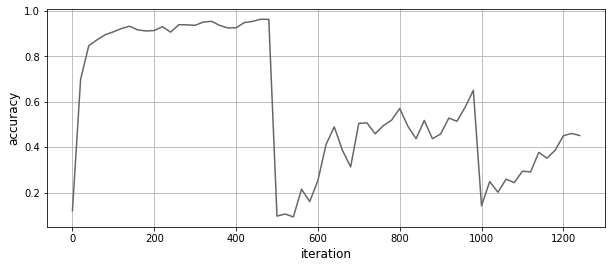

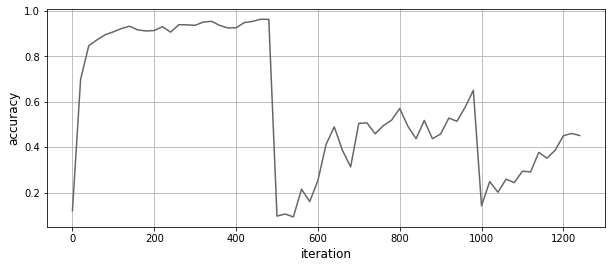

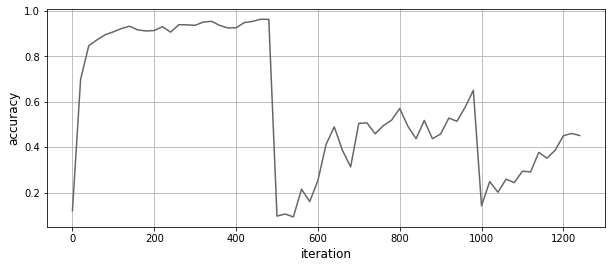

<Figure size 720x288 with 0 Axes>

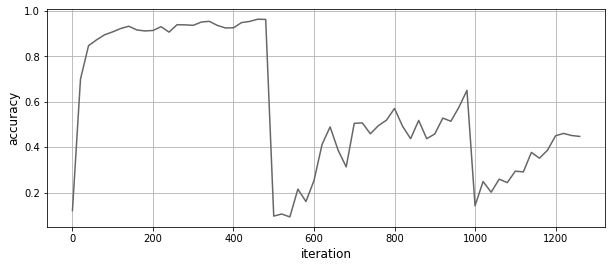

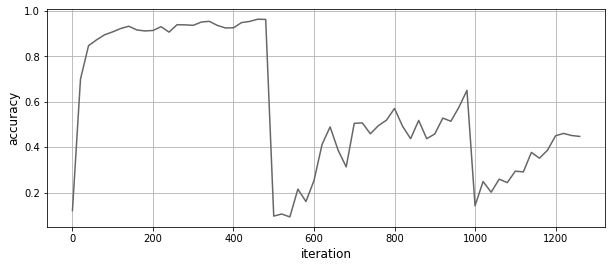

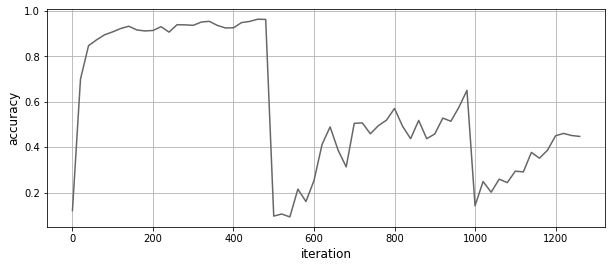

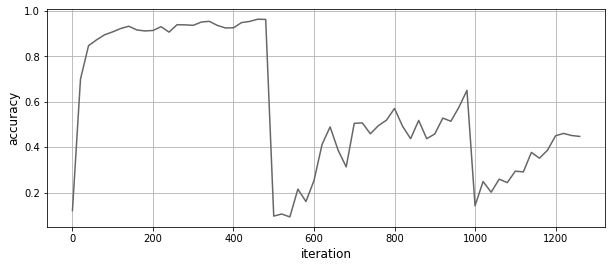

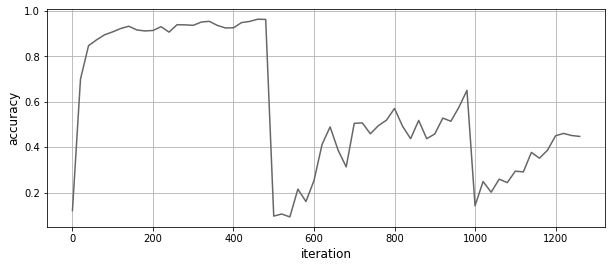

...

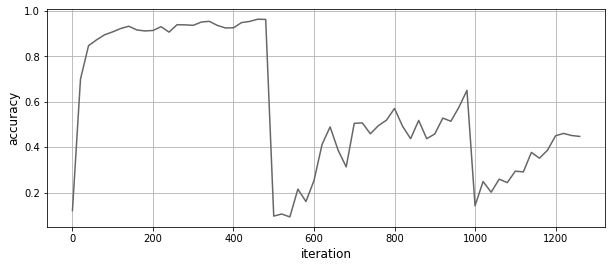

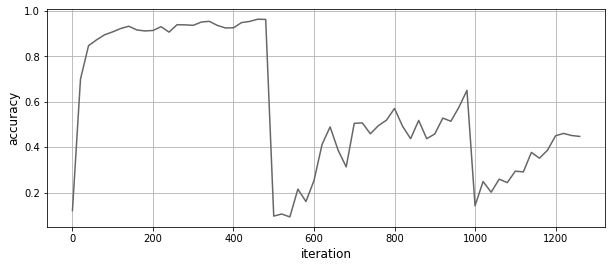

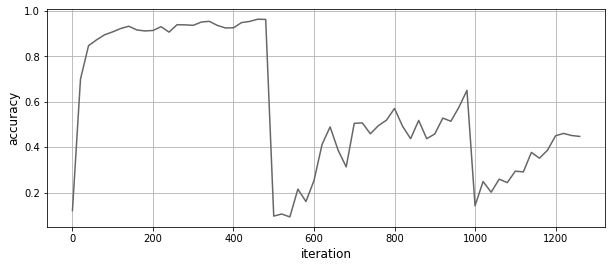

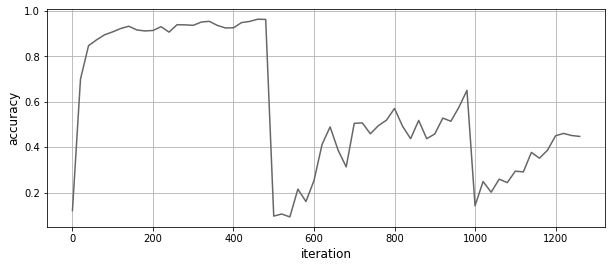

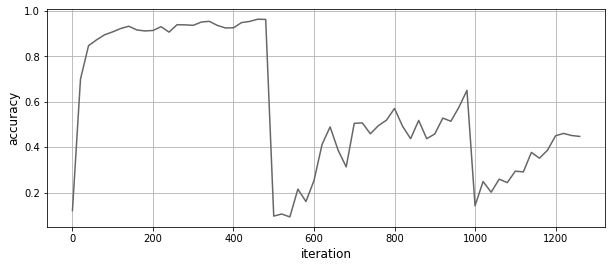

<Figure size 720x288 with 0 Axes>

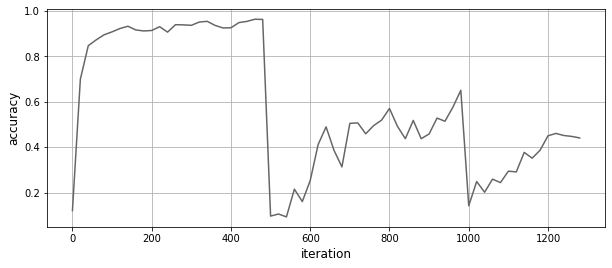

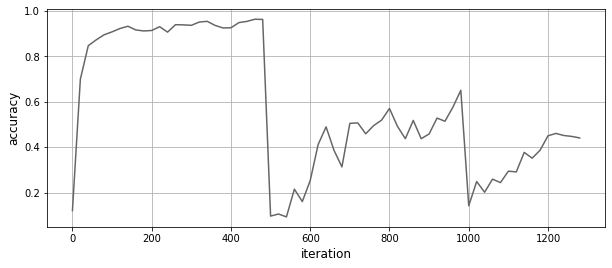

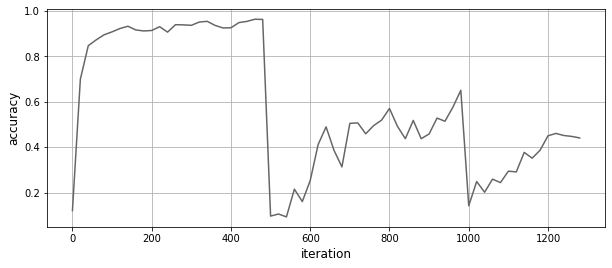

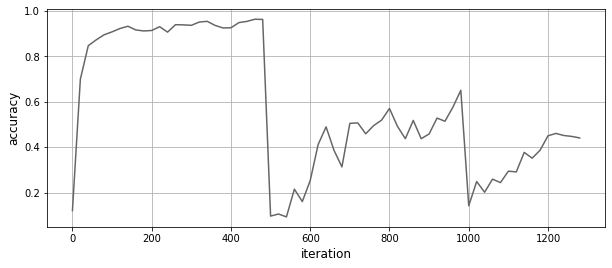

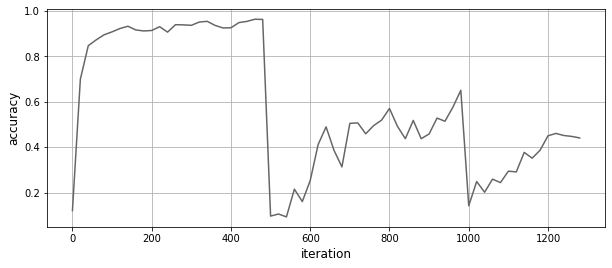

...

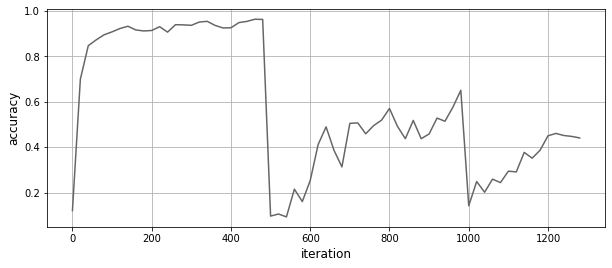

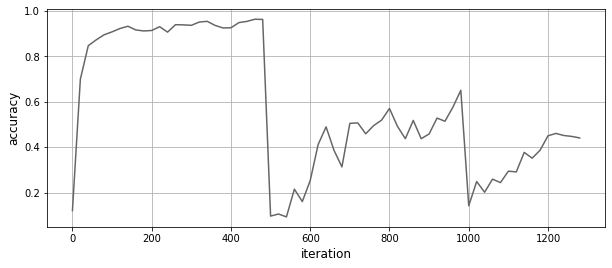

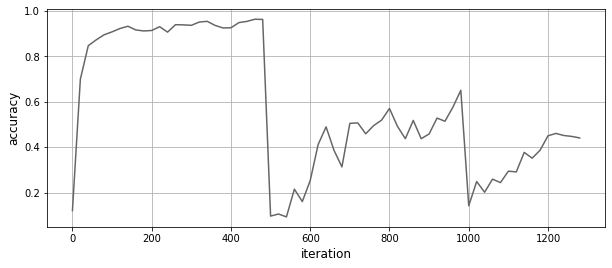

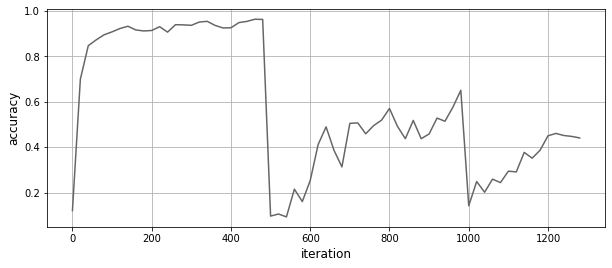

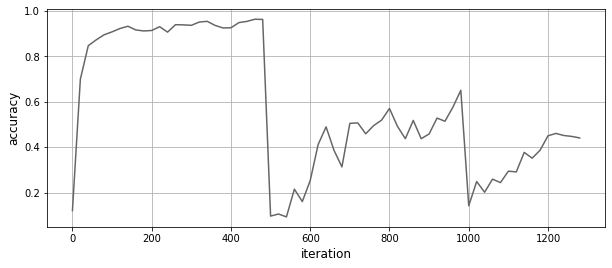

<Figure size 720x288 with 0 Axes>

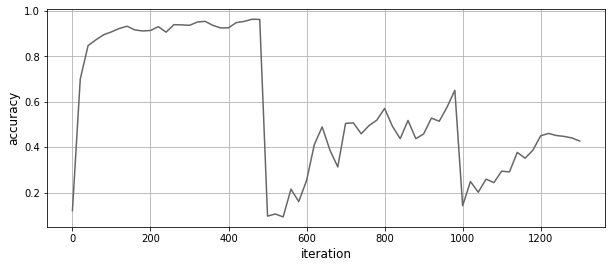

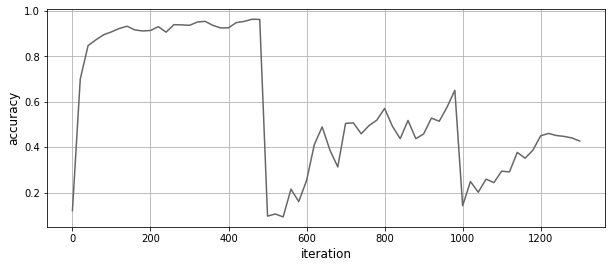

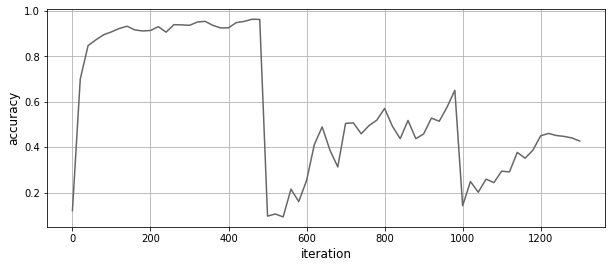

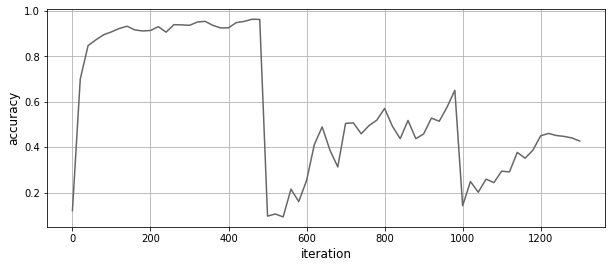

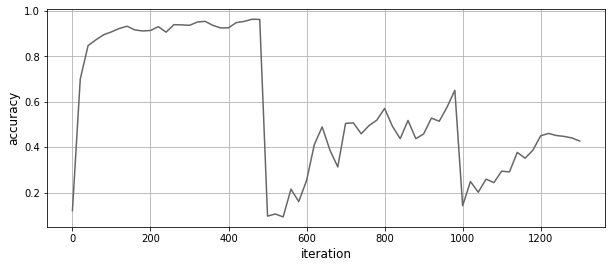

...

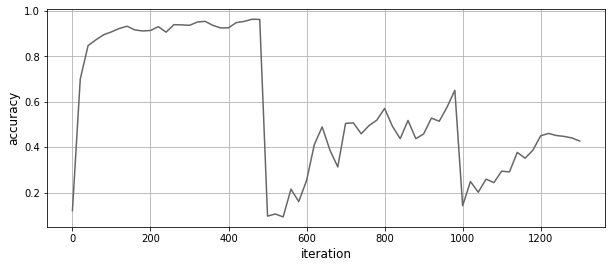

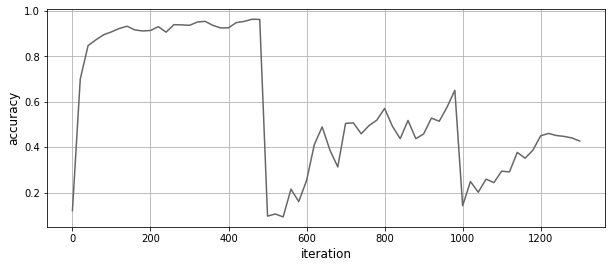

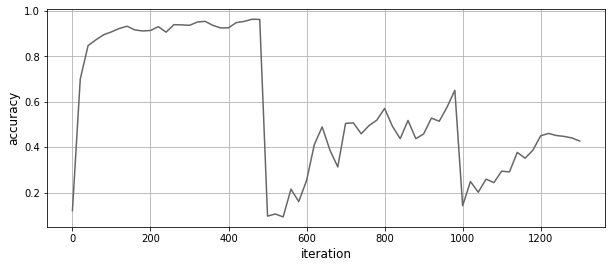

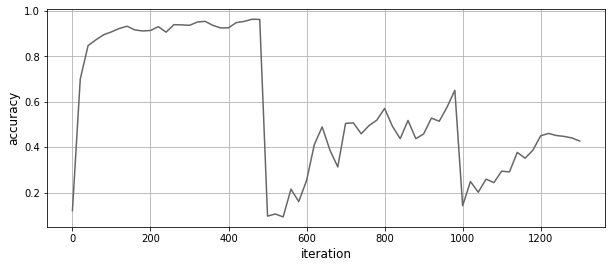

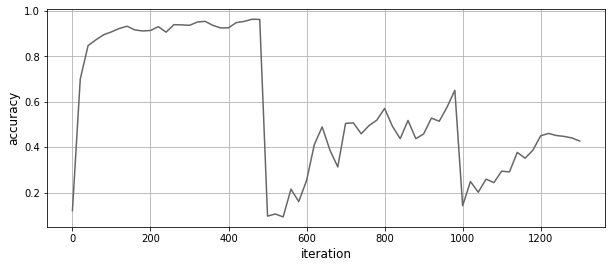

<Figure size 720x288 with 0 Axes>

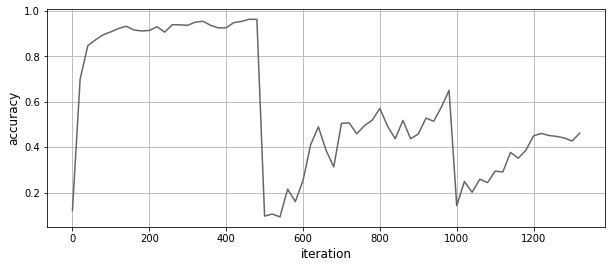

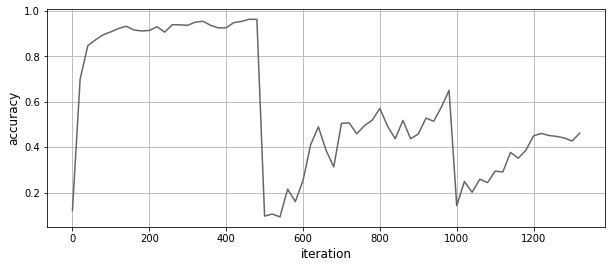

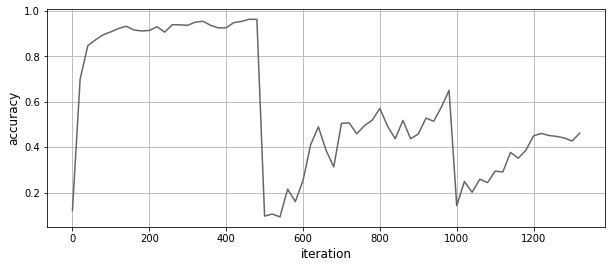

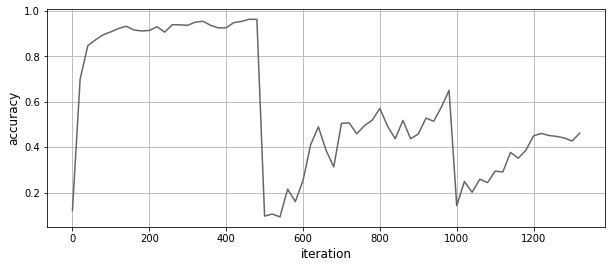

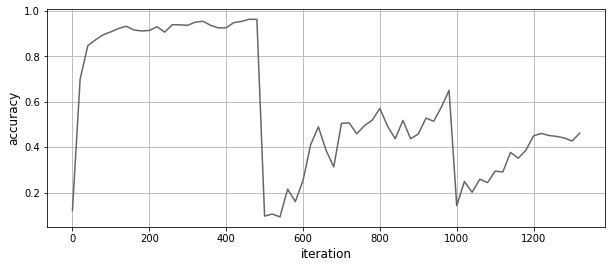

...

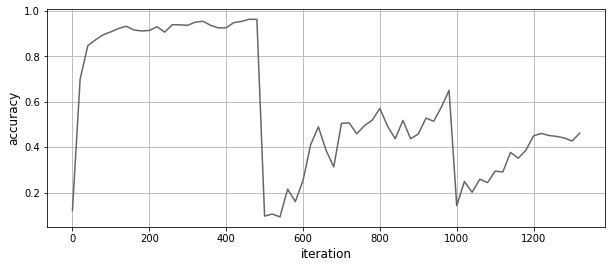

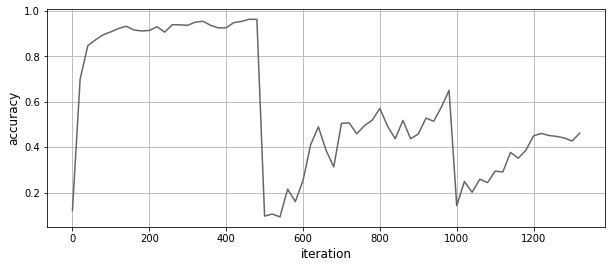

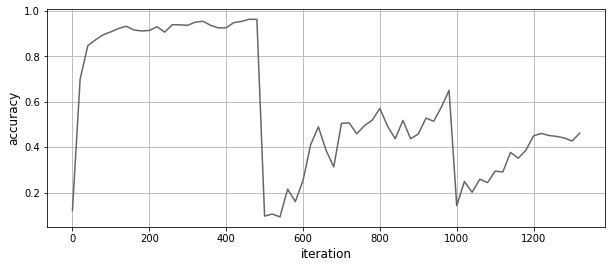

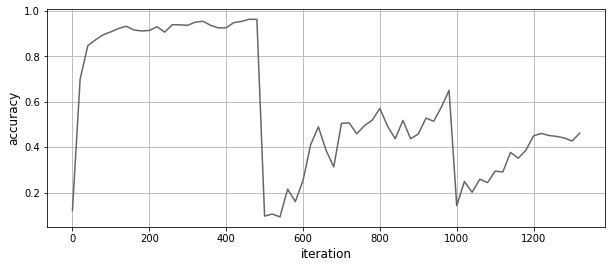

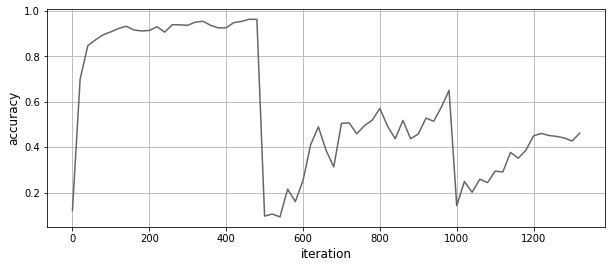

<Figure size 720x288 with 0 Axes>

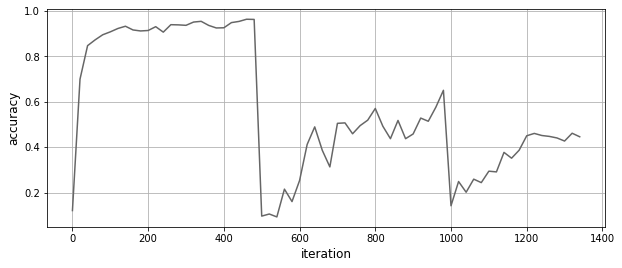

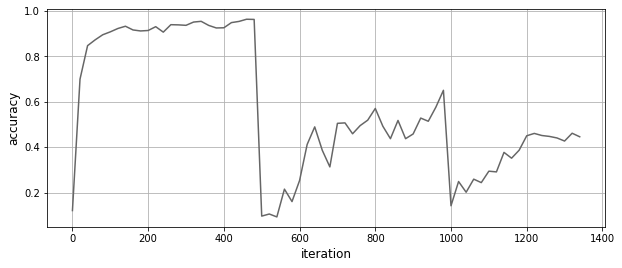

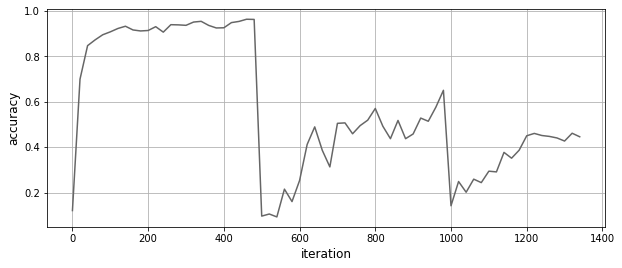

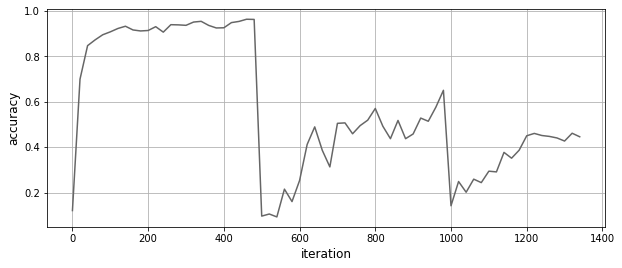

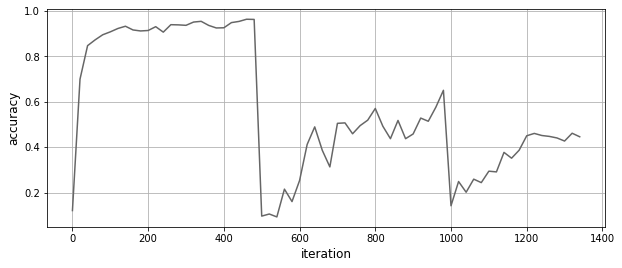

...

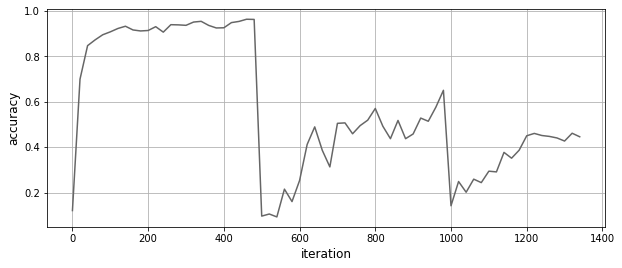

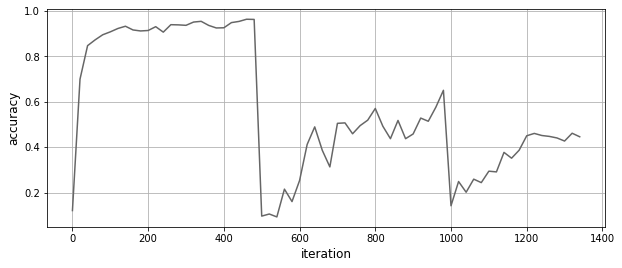

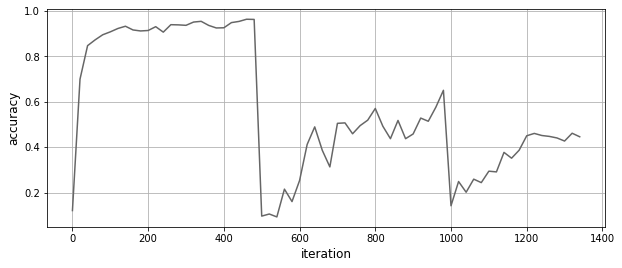

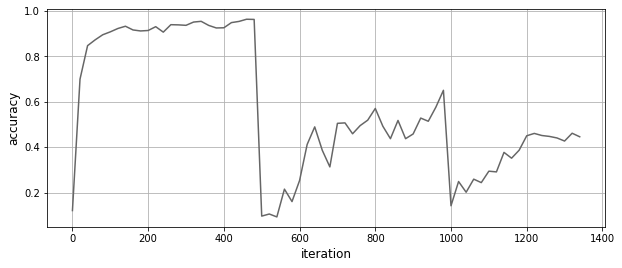

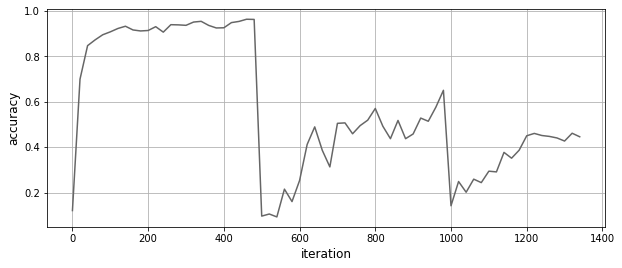

<Figure size 720x288 with 0 Axes>

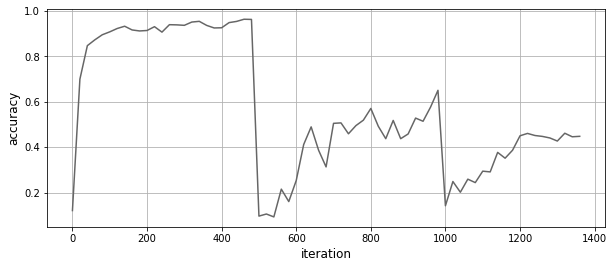

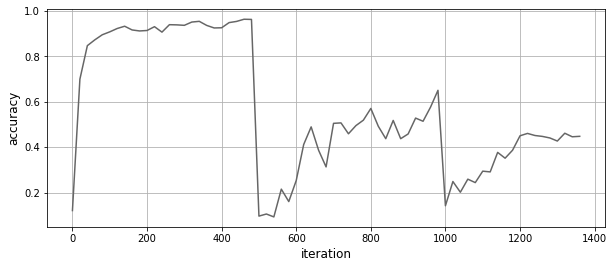

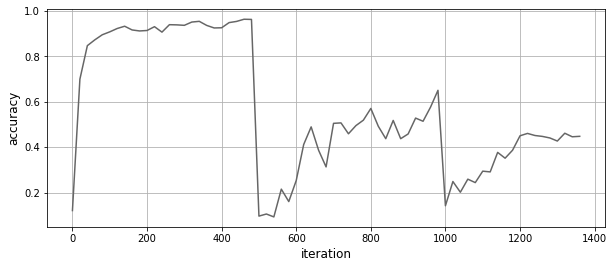

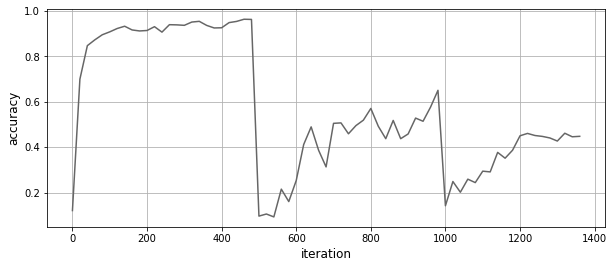

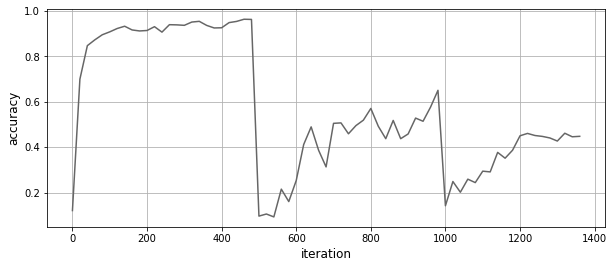

...

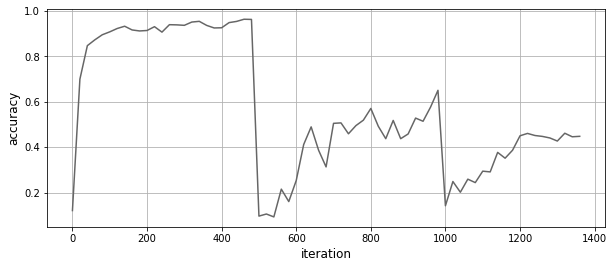

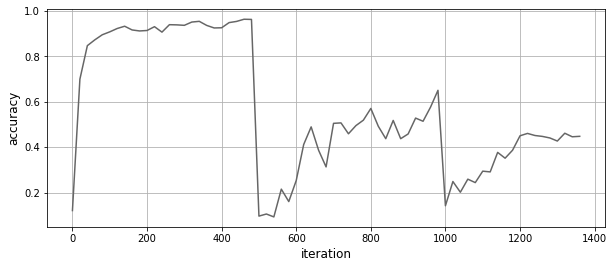

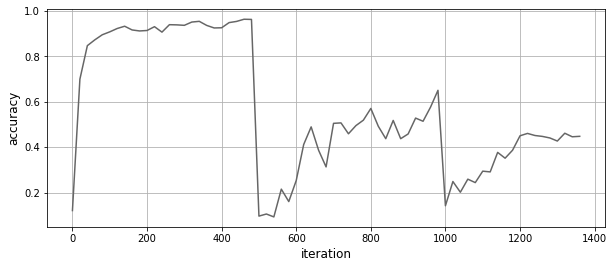

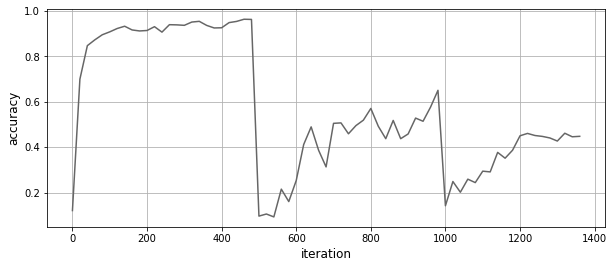

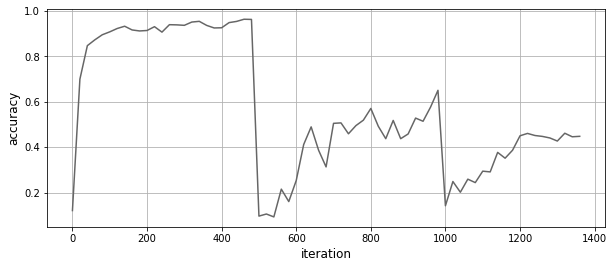

<Figure size 720x288 with 0 Axes>

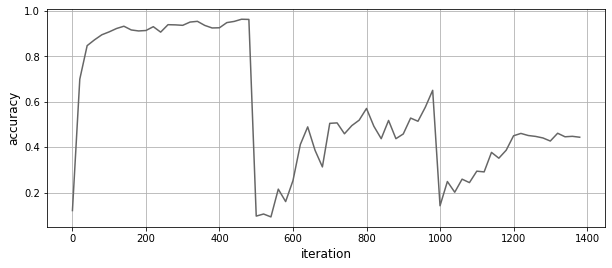

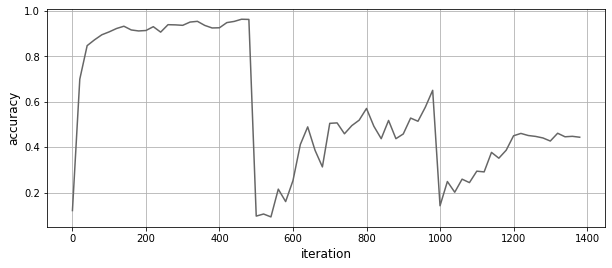

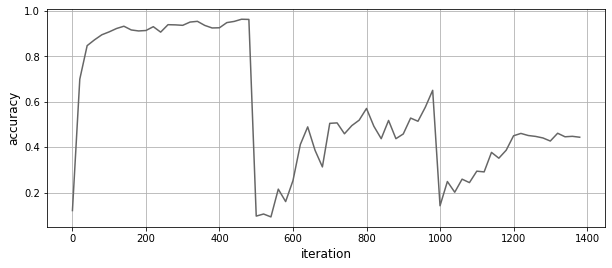

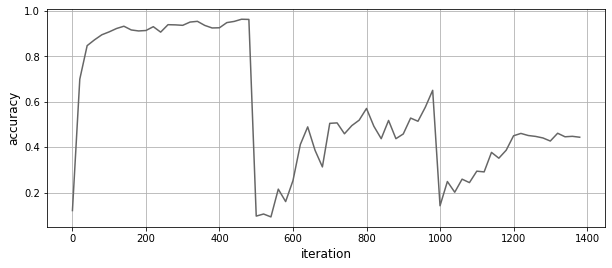

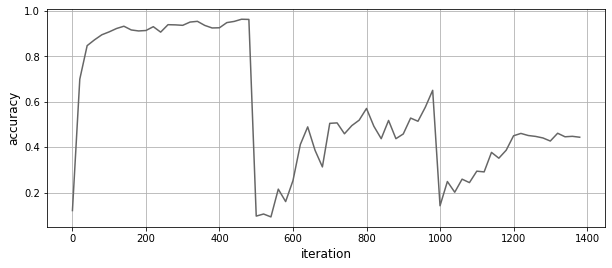

...

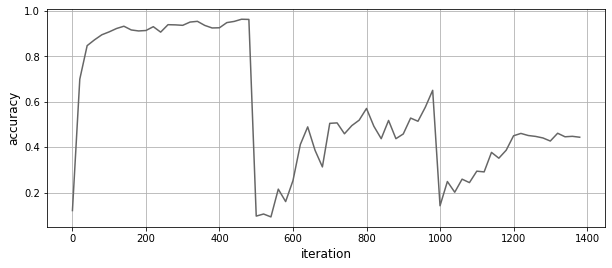

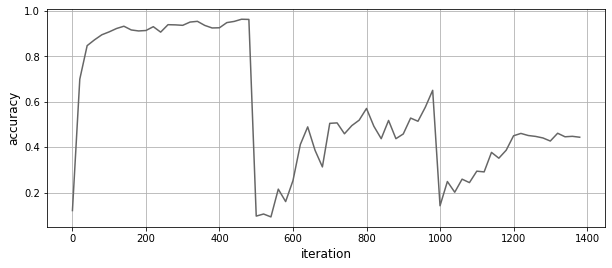

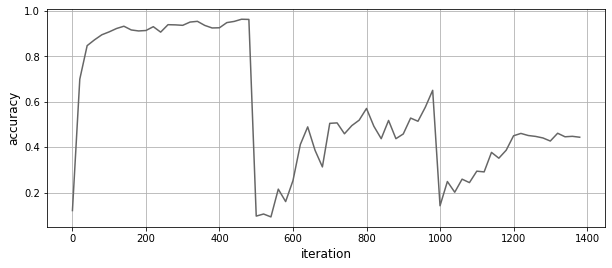

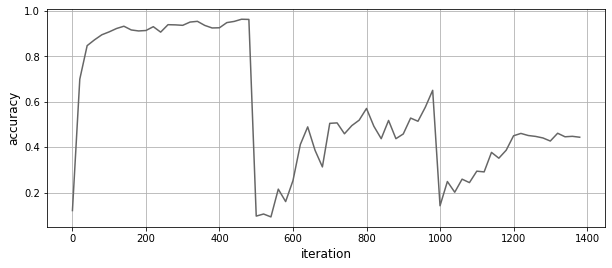

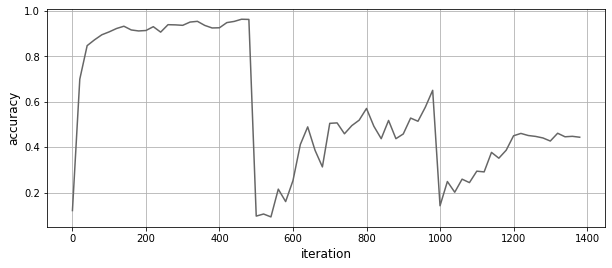

<Figure size 720x288 with 0 Axes>

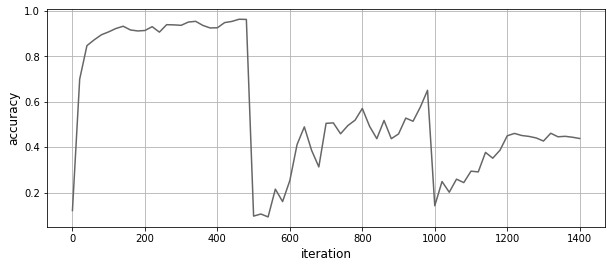

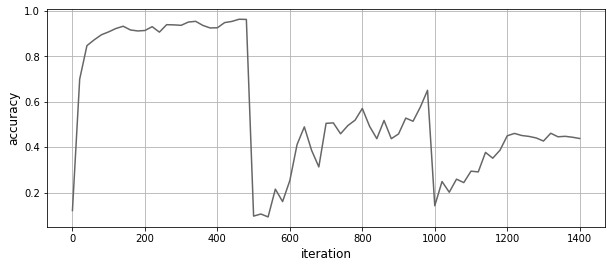

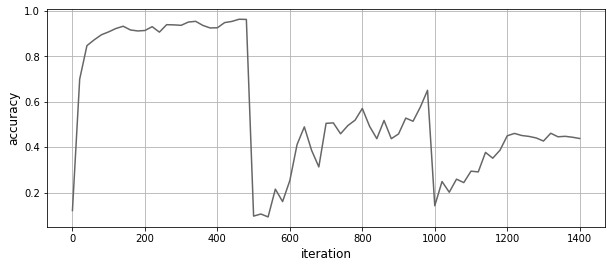

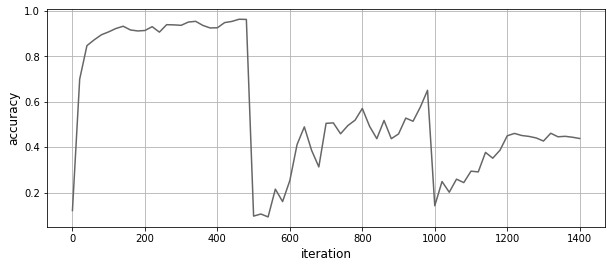

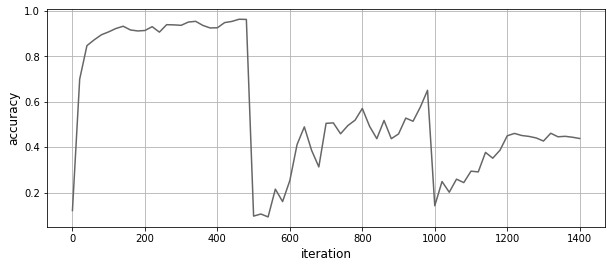

...

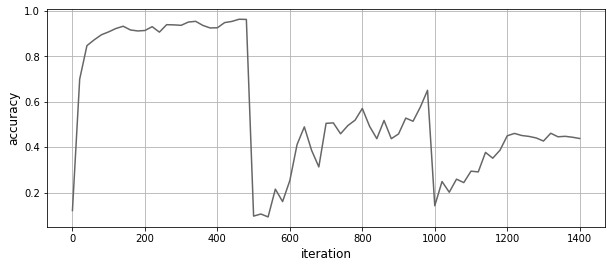

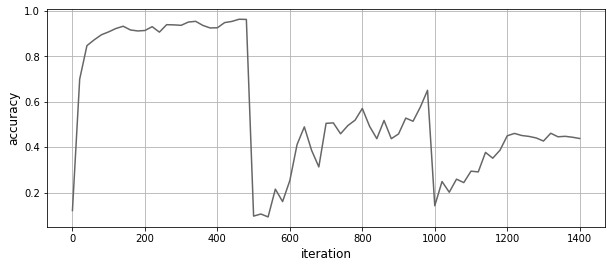

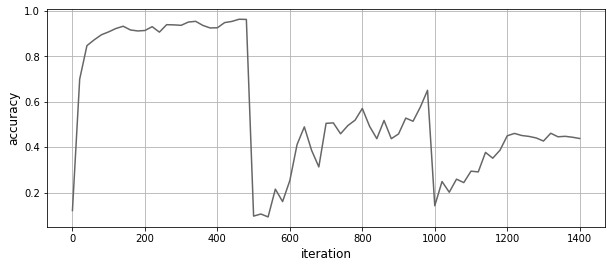

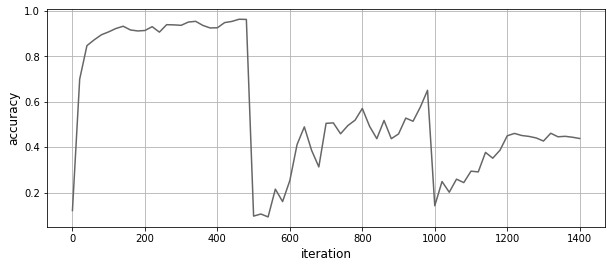

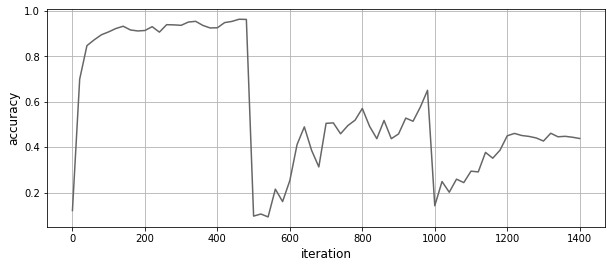

<Figure size 720x288 with 0 Axes>

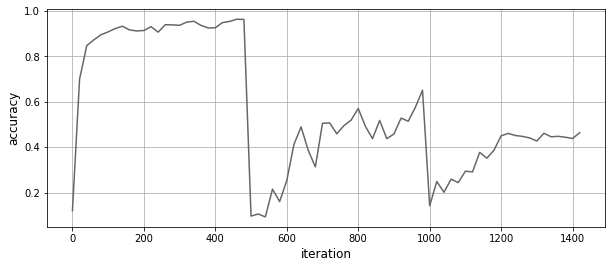

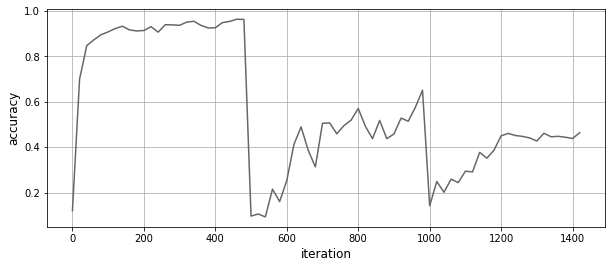

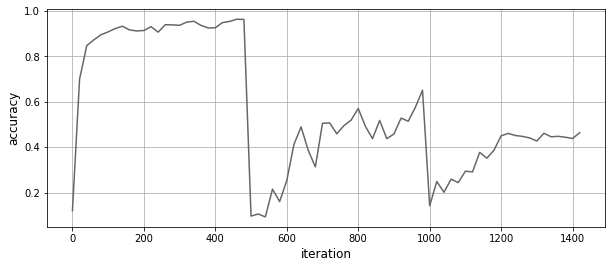

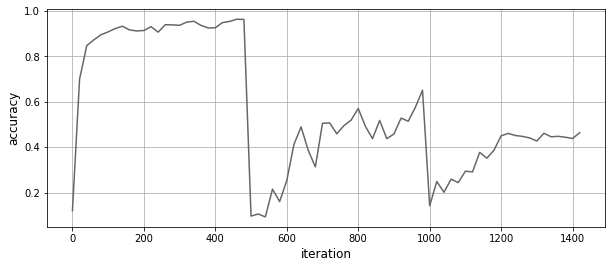

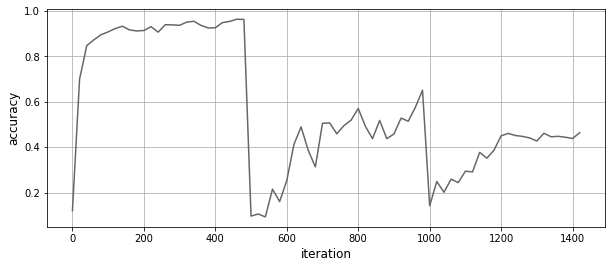

...

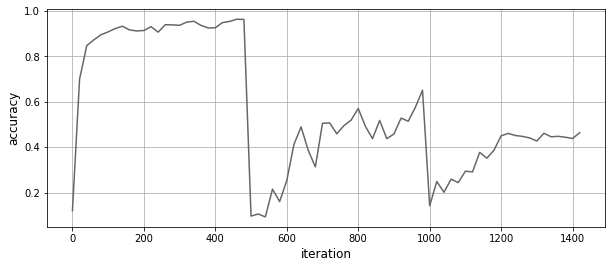

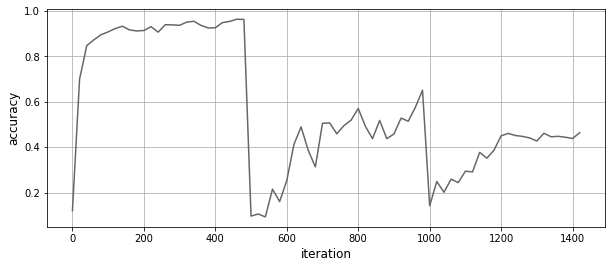

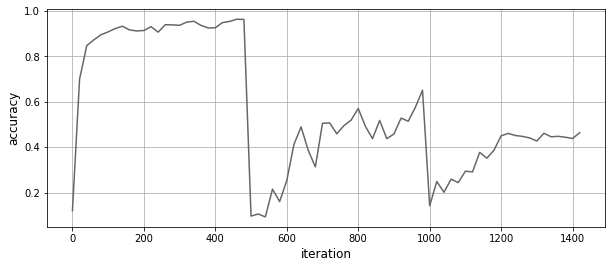

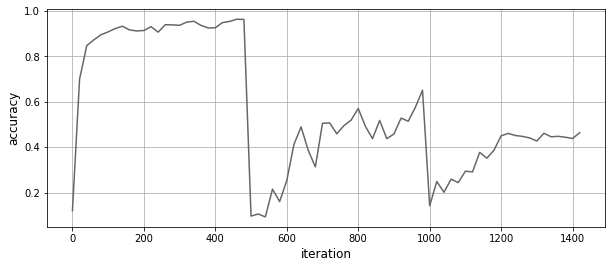

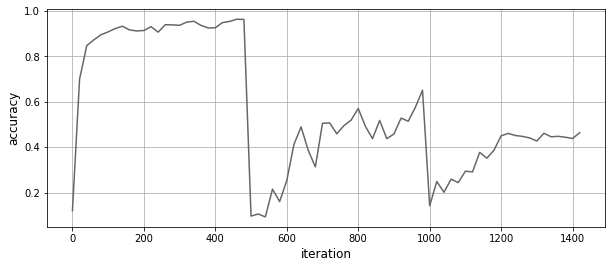

<Figure size 720x288 with 0 Axes>

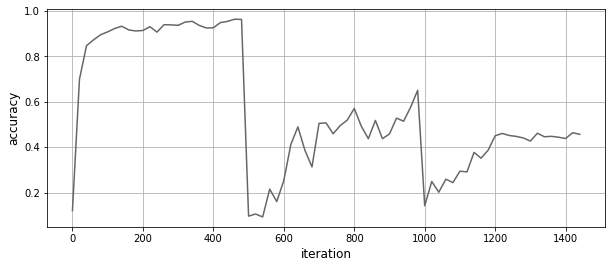

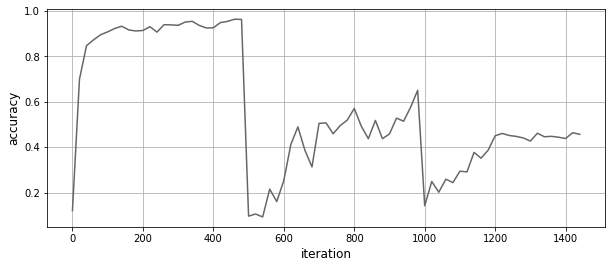

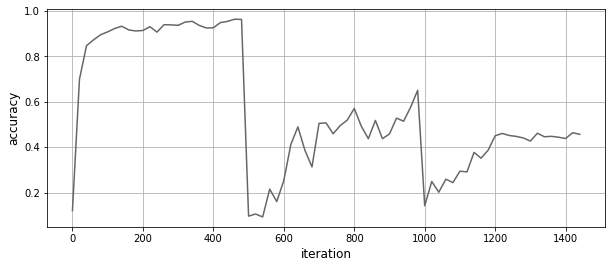

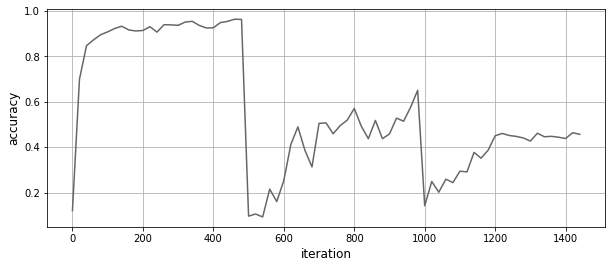

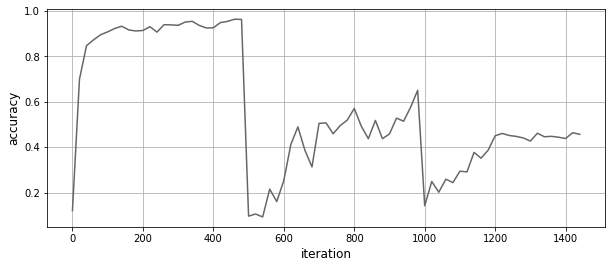

...

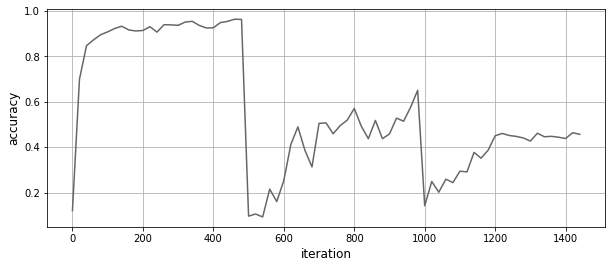

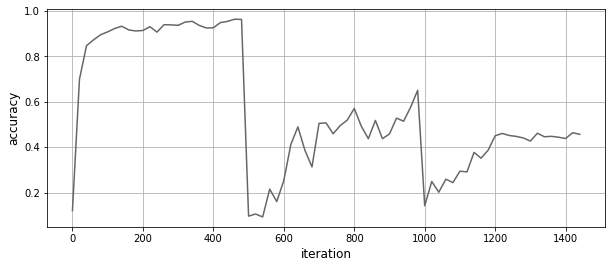

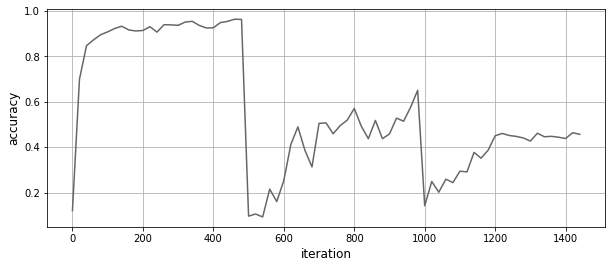

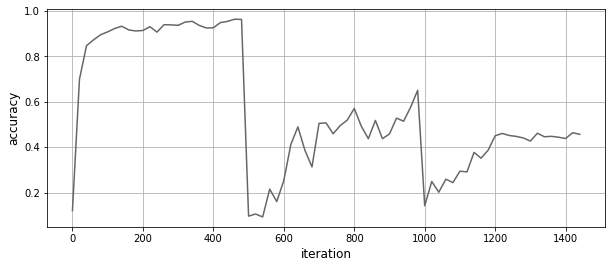

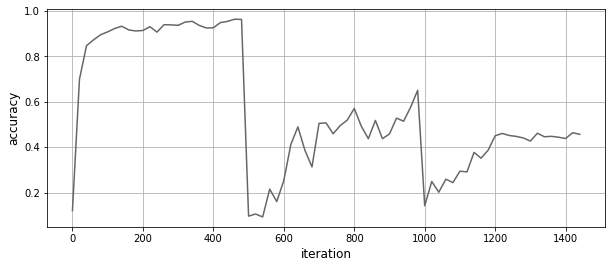

<Figure size 720x288 with 0 Axes>

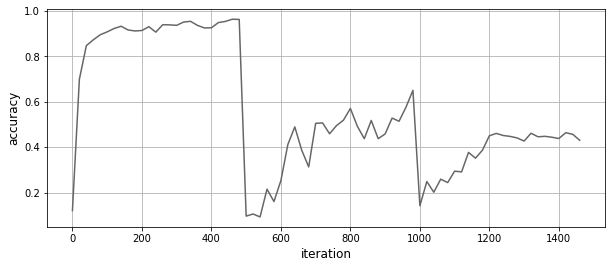

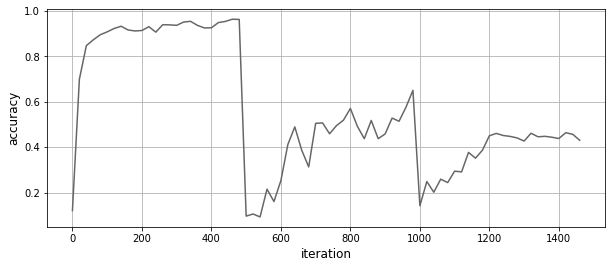

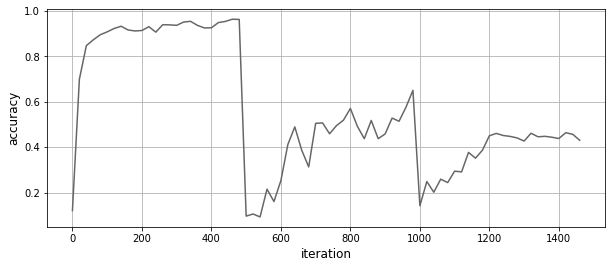

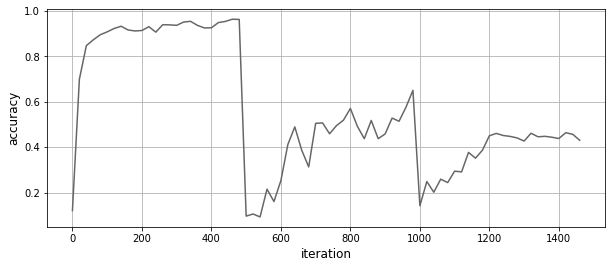

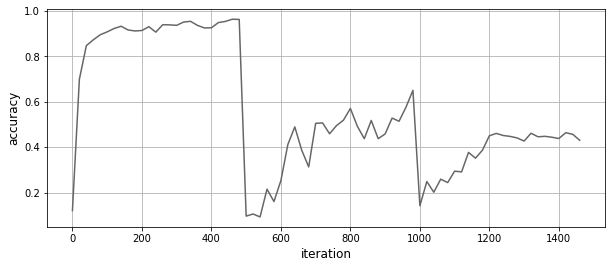

...

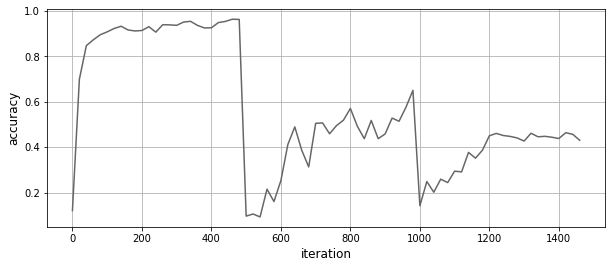

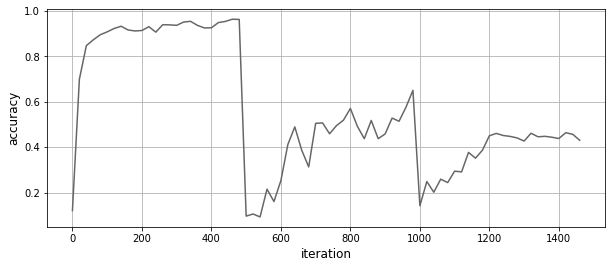

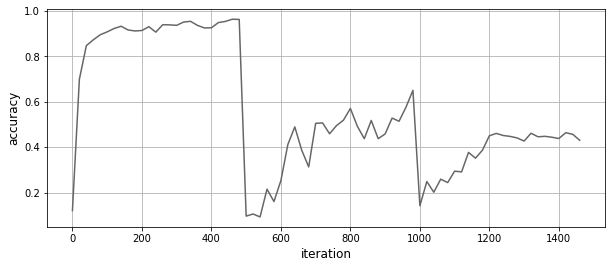

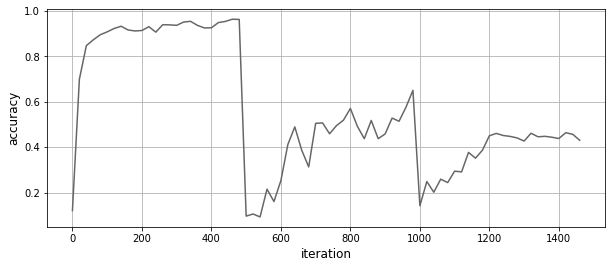

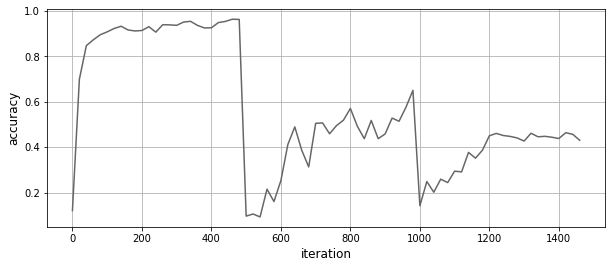

<Figure size 720x288 with 0 Axes>

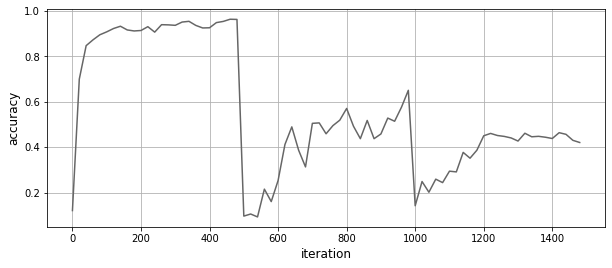

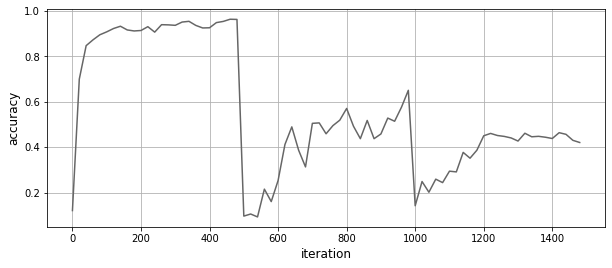

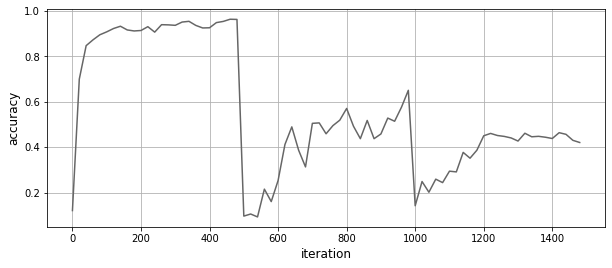

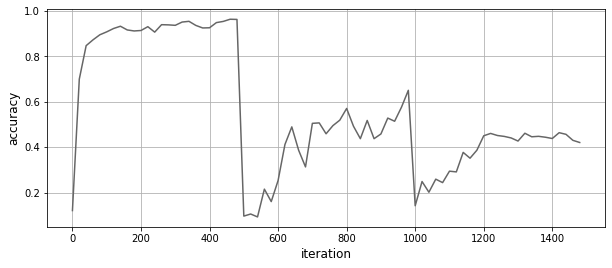

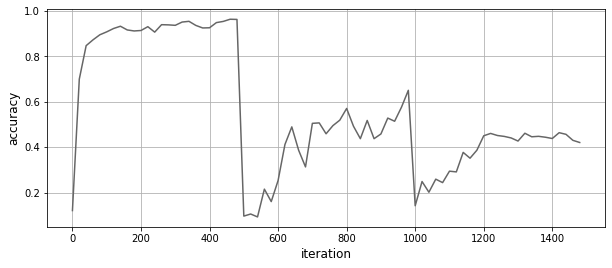

...

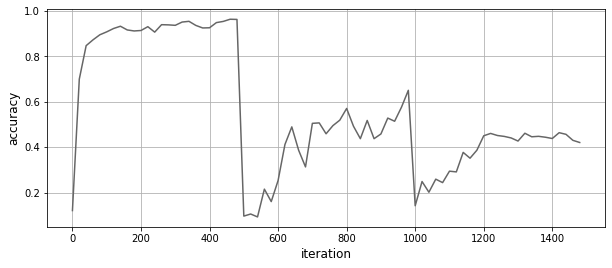

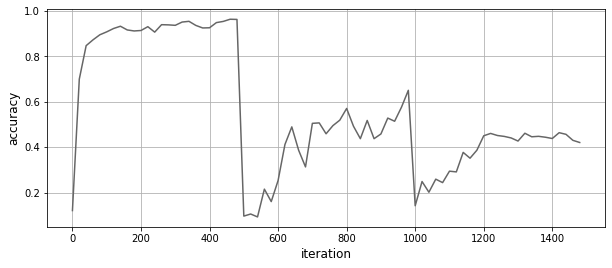

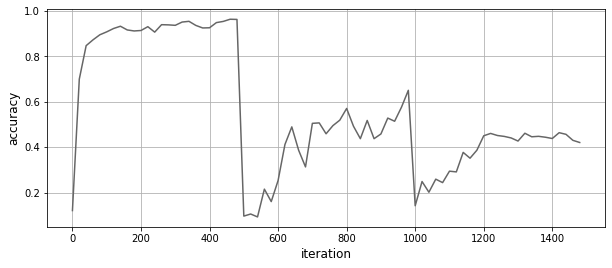

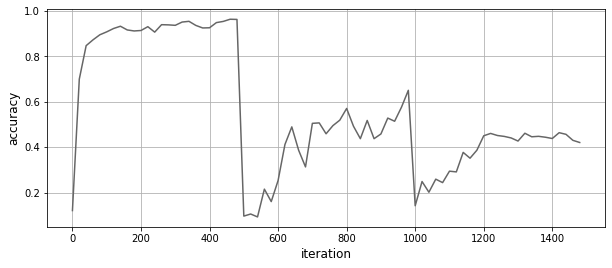

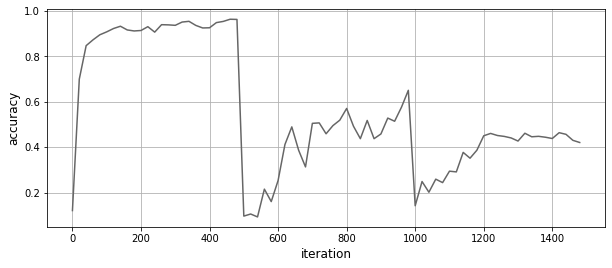

In [50]:
for i in range(1500):
    batch_X, batch_y = mnist.train.next_batch(50)
    batch_X = np.reshape(batch_X, (-1, 28, 28, 1))
    
    feed_dict = {inputs: batch_X, labels: batch_y}
    
    if i < 500:
        sess.run(train_step, feed_dict=feed_dict)
        
        if i%20==0:
            acc = plot_accuracy(i)
            iters.append(i)
            iters_acc.append(acc)
#             print('iter:', i, 'test accuracy:', acc)
        
    elif i >= 500 and i < 1000:
        if i%500==0:
            print('iter:', i, 'prune weights')
            for L in LAYERS:
                L.prune_weights(sess, threshold=0.1)
        
        grads_data = sess.run(grads, feed_dict={inputs: batch_X, labels: batch_y})
        feed_dict = {}
        
        for L, grad, grad_data in zip(LAYERS, grads, grads_data):
            pruned_grad_data = L.prune_weights_gradient(grad_data)
            feed_dict[grad] = pruned_grad_data
            
        sess.run(train_step, feed_dict=feed_dict)
        
        if i%20==0:
            acc = plot_accuracy(i)
            iters.append(i)
            iters_acc.append(acc)
#             print('iter:', i, 'test accuracy:', acc)
        
        for L in LAYERS:
            L.prune_weights_update(sess)
    else:
        if i==1000:
            print('iters:', i, "quantize_weights")
            for L in LAYERS:
                L.quantize_weights(sess)
        
        grads_data = sess.run(grads, feed_dict={inputs: batch_X, labels: batch_y})
        feed_dict = {}
        
        for L, grad, grad_data in zip(LAYERS, grads, grads_data):
            grouped_grad_data = L.group_and_reduce_gradient(grad_data)
            feed_dict[grad] = grouped_grad_data
        
        sess.run(train_step, feed_dict=feed_dict)
        
        for L in LAYERS:
            L.quantize_centroids_update(sess)
            L.quantize_weights_update(sess)
        
        if i%20 == 0:
            acc = plot_accuracy(i)
            iters.append(i)
            iters_acc.append(acc)

            for L in LAYERS:
                L.save_weights_histogram(sess, histograms_dir, i)
    
    for L in LAYERS:
        L.save_weights(sess, weights_dir)

    plt.figure(figsize=(10, 4))
    plt.ylabel('accuracy', fontsize=12)
    plt.xlabel('iteration', fontsize=12)
    plt.grid(True)
    plt.plot(iters, iters_acc, color='0.4')
    plt.savefig('./train_acc', dpi=1500)

## Testing

In [51]:
batches_accuracy = []

for i in range(10):
    batch_X, batch_y = mnist.test.next_batch(1000)
    batch_X = np.reshape(batch_X, (-1, 28, 28, 1))
    
    batch_acc = sess.run(accuracy, feed_dict={inputs: batch_X, labels: batch_y})
    batches_accuracy.append(batch_acc)
    
acc = np.mean(batches_accuracy)

print("deploy accuracy:", acc)

deploy accuracy: 0.4594
